<a href="https://colab.research.google.com/github/ram130849/object_detection_using_faster_rcnn/blob/main/Final_ExDark.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Computer Vision Project ExDark Dataset Notebook


In [1]:
# Reference Notebook that I modified/adapted : https://colab.research.google.com/drive/16jcaJoc6bCFAQ96jDe2HwtXj7BMD_-m5
# The above note book is a tutorial to use detectron2 APIs run inference with an existing model and train a builtin model on a custom dataset
# We also referred to this notebook that has used our dataset and the detectron2 tutorial: https://github.com/Yashsshah909/Object-detection-of-low-light-images-using-the-Exclusively-Dark-ExDark-dataset./blob/main/Fast_RCNN_and_Faster_RCNN.ipynb


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
import pandas as pd
import numpy as np
import re
# from tqdm.notebook import tqdm
import tqdm
import xml.etree.ElementTree as ET
from pathlib import Path
import cv2
import os
import shutil
from sklearn import model_selection, preprocessing
import seaborn as sns
import matplotlib.pyplot as plt

In [4]:
!unzip '/content/drive/MyDrive/ExDark/ExDark.zip' -d '/content/'

Streaming output truncated to the last 5000 lines.
  inflating: /content/ExDark/Motorbike/2017_07361.jpg  
  inflating: /content/__MACOSX/ExDark/Motorbike/._2017_07361.jpg  
  inflating: /content/ExDark/Motorbike/2015_06160.jpg  
  inflating: /content/__MACOSX/ExDark/Motorbike/._2015_06160.jpg  
  inflating: /content/ExDark/Motorbike/2015_05864.jpg  
  inflating: /content/__MACOSX/ExDark/Motorbike/._2015_05864.jpg  
  inflating: /content/ExDark/Motorbike/2015_05870.jpg  
  inflating: /content/__MACOSX/ExDark/Motorbike/._2015_05870.jpg  
  inflating: /content/ExDark/Motorbike/2015_05858.jpg  
  inflating: /content/__MACOSX/ExDark/Motorbike/._2015_05858.jpg  
  inflating: /content/ExDark/Motorbike/2015_05874.jpg  
  inflating: /content/__MACOSX/ExDark/Motorbike/._2015_05874.jpg  
  inflating: /content/ExDark/Motorbike/2015_05860.jpg  
  inflating: /content/__MACOSX/ExDark/Motorbike/._2015_05860.jpg  
  inflating: /content/ExDark/Motorbike/2015_05848.jpg  
  inflating: /content/__MACOSX/E

In [5]:
!unzip '/content/drive/MyDrive/ExDark/ExDark_Annno.zip' -d '/content/'

Streaming output truncated to the last 5000 lines.
  inflating: /content/ExDark_Annno/Motorbike/2015_05787.jpg.txt  
  inflating: /content/__MACOSX/ExDark_Annno/Motorbike/._2015_05787.jpg.txt  
  inflating: /content/ExDark_Annno/Motorbike/2015_05797.jpg.txt  
  inflating: /content/__MACOSX/ExDark_Annno/Motorbike/._2015_05797.jpg.txt  
  inflating: /content/ExDark_Annno/Motorbike/2015_05933.jpg.txt  
  inflating: /content/__MACOSX/ExDark_Annno/Motorbike/._2015_05933.jpg.txt  
  inflating: /content/ExDark_Annno/Motorbike/2015_05923.jpg.txt  
  inflating: /content/__MACOSX/ExDark_Annno/Motorbike/._2015_05923.jpg.txt  
  inflating: /content/ExDark_Annno/Motorbike/2015_05951.jpg.txt  
  inflating: /content/__MACOSX/ExDark_Annno/Motorbike/._2015_05951.jpg.txt  
  inflating: /content/ExDark_Annno/Motorbike/2015_05829.jpg.txt  
  inflating: /content/__MACOSX/ExDark_Annno/Motorbike/._2015_05829.jpg.txt  
  inflating: /content/ExDark_Annno/Motorbike/2015_05941.jpg.txt  
  inflating: /content/__M

In [6]:
# Class and Property Dictionarties for Dataset 
class_size=13
reverse_class_dict = {'bicycle': 1, 'boat': 2, 'bottle': 3, 'bus': 4, 'car': 5, 'cat': 6, 'chair': 7, 'cup': 8, 'dog': 9, 'motorbike': 10, 'people': 11, 'table': 12}
class_dict = {1:'Bicycle',2:'Boat',3:'Bottle',4:'Bus',5:'Car',6:'Cat',7:'Chair',8:'Cup',9:'Dog',10:'Motorbike',11:'People',12:'Table'}
total_dict = {0:'BackGround',1:'Bicycle',2:'Boat',3:'Bottle',4:'Bus',5:'Car',6:'Cat',7:'Chair',8:'Cup',9:'Dog',10:'Motorbike',11:'People',12:'Table'}
light_dict = {1:'Low',2:'Ambient',3:'Object',4:'Single',5:'Weak',6:'Strong',7:'Screen',8:'Window',9:'Shadow',10:'Twilight'}
in_out_dict = {1:'Indoor',2:'Outdoor'}
train_val_test = {1:'train',2:'val',3:'test'}

In [7]:
classes = [val.lower() for val in list(class_dict.values())]

In [8]:
print( list(class_dict.keys()) [list(class_dict.values()).index('Bicycle')] )

1


In [9]:
!cp '/content/drive/MyDrive/ExDark/imageclasslist.txt' -d '/content/'

In [10]:
# Build Dataframe
df = pd.read_csv('/content/imageclasslist.txt',sep=' ',header=None,skiprows=1)
df.columns = ['Name','Class','Light','In/Out','Train/Val/Test']

In [11]:
# Build Dataframe
df.loc[df.Class==1,'Name'] = '/content/ExDark/' + class_dict[1] + '/' +  df['Name']
df.loc[df.Class==2,'Name'] = '/content/ExDark/' + class_dict[2] + '/' +  df['Name']
df.loc[df.Class==3,'Name'] = '/content/ExDark/' + class_dict[3] + '/' +  df['Name']
df.loc[df.Class==4,'Name'] = '/content/ExDark/' + class_dict[4] + '/' +  df['Name']
df.loc[df.Class==5,'Name'] = '/content/ExDark/' + class_dict[5] + '/' +  df['Name']
df.loc[df.Class==6,'Name'] = '/content/ExDark/' + class_dict[6] + '/' +  df['Name']
df.loc[df.Class==7,'Name'] = '/content/ExDark/' + class_dict[7] + '/' +  df['Name']
df.loc[df.Class==8,'Name'] = '/content/ExDark/' + class_dict[8] + '/' +  df['Name']
df.loc[df.Class==9,'Name'] = '/content/ExDark/' + class_dict[9] + '/' +  df['Name']
df.loc[df.Class==10,'Name'] = '/content/ExDark/' + class_dict[10] + '/' + df['Name']
df.loc[df.Class==11,'Name'] = '/content/ExDark/' + class_dict[11] + '/' +df['Name']
df.loc[df.Class==12,'Name'] = '/content/ExDark/' + class_dict[12] + '/' +df['Name']

In [12]:
print(df.head(10))

                                     Name  Class  Light  In/Out  \
0  /content/ExDark/Bicycle/2015_00001.png      1      2       1   
1  /content/ExDark/Bicycle/2015_00002.png      1      6       2   
2  /content/ExDark/Bicycle/2015_00003.png      1      5       2   
3  /content/ExDark/Bicycle/2015_00004.jpg      1      3       2   
4  /content/ExDark/Bicycle/2015_00005.jpg      1      6       2   
5  /content/ExDark/Bicycle/2015_00006.jpg      1      6       2   
6  /content/ExDark/Bicycle/2015_00007.jpg      1      2       2   
7  /content/ExDark/Bicycle/2015_00008.jpg      1      6       2   
8  /content/ExDark/Bicycle/2015_00009.jpg      1      6       2   
9  /content/ExDark/Bicycle/2015_00010.jpg      1      5       2   

   Train/Val/Test  
0               1  
1               1  
2               1  
3               1  
4               1  
5               1  
6               1  
7               1  
8               1  
9               1  


In [13]:
print(len(df))

7363


In [14]:
# Analyze count/split of Dataset
train_val_test_count = df['Train/Val/Test'].value_counts().rename_axis('train_val_test')
train_count = train_val_test_count[1] 
val_count = train_val_test_count[2]
test_count = train_val_test_count[3]
print('train,val,test:',train_count,val_count,test_count)
train_count = train_count + val_count
test_count = test_count

print("total count: {}".format(train_count+test_count))

train,val,test: 3000 1800 2563
total count: 7363


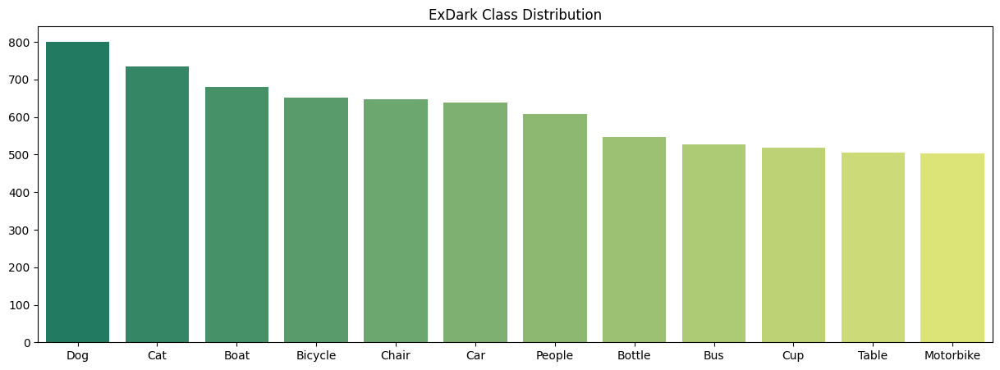

In [15]:
# Visulaize Class Dist
class_labels = dict(df['Class'].value_counts())

labels = []

count = []

for i,j in class_labels.items():

    labels.append(class_dict[i])

    count.append(j)

plt.figure(figsize=(15,5))
sns.barplot(x=labels,y=count,palette='summer')
plt.title('ExDark Class Distribution')
plt.show()

In/Out Distribution: ['Outdoor', 'Indoor'] [4541, 2822]
Lightning Condt Distribution: ['Ambient', 'Strong', 'Single', 'Weak', 'Object', 'Twilight', 'Window', 'Low', 'Screen', 'Shadow'] [2098, 2059, 762, 705, 498, 416, 363, 241, 165, 56]


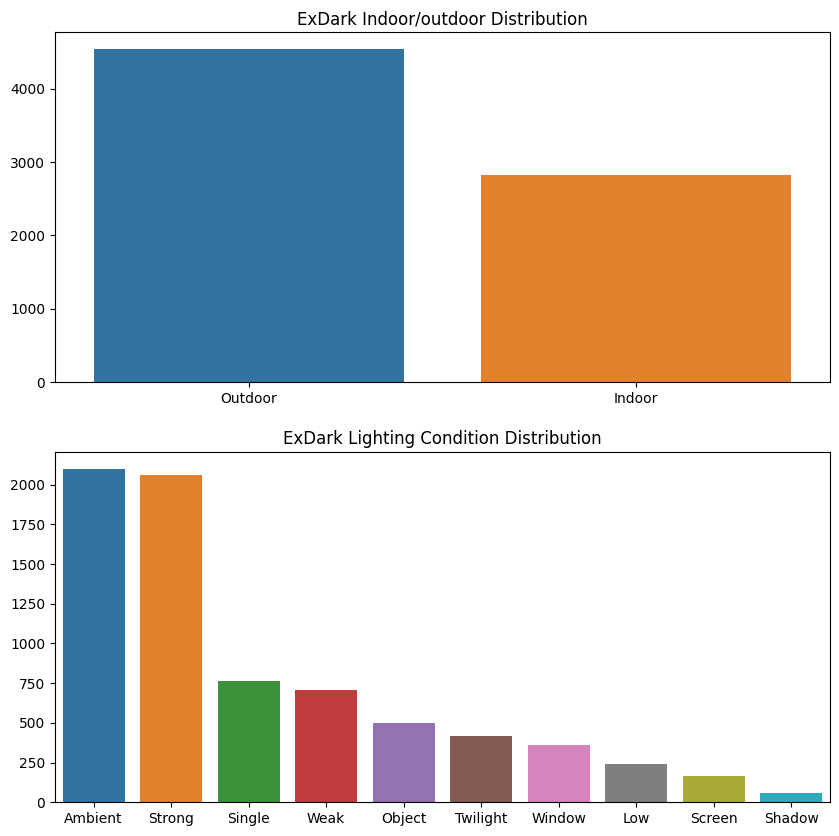

In [16]:
# function to get indoor/outdoor / lighting dist for each class
# global df
#df1 = df[df['Class']==label]

df1 = df

in_out = dict(df1['In/Out'].value_counts())
light_cond = dict(df1['Light'].value_counts())

in_out_label =[]
in_out_cnt =[]
for i,j in in_out.items():
    in_out_label.append(in_out_dict[i])
    in_out_cnt.append(j)

light_label = []
light_cnt = []
for i,j in light_cond.items():
    light_label.append(light_dict[i])
    light_cnt.append(j)

print('In/Out Distribution:',in_out_label,in_out_cnt)
print('Lightning Condt Distribution:',light_label,light_cnt)

fig,axis = plt.subplots(2,1,figsize=(10,10))
axis1 = sns.barplot(x=in_out_label,y=in_out_cnt,ax=axis[0])
axis1.set_title('ExDark Indoor/outdoor Distribution')
axis2 = sns.barplot(x=light_label,y=light_cnt,ax=axis[1])
axis2.set_title('ExDark Lighting Condition Distribution')
plt.show()

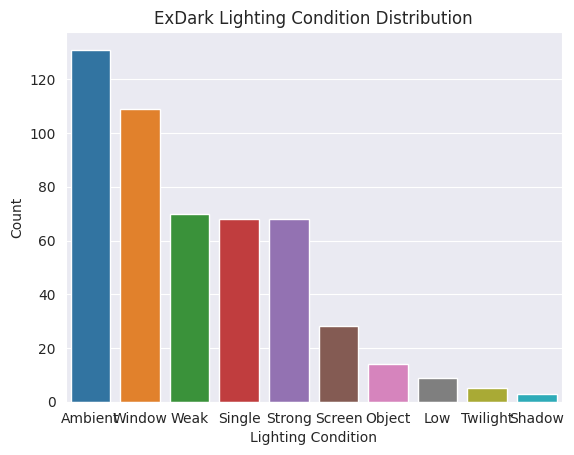

In [48]:
sns.set_style('darkgrid')

# Plot lighting condition distribution
sns.barplot(x=light_label, y=light_cnt)
plt.title('ExDark Lighting Condition Distribution')
plt.xlabel('Lighting Condition')
plt.ylabel('Count')
plt.savefig('exdark_lighting.png', dpi=300, bbox_inches='tight')

Bicycle In/Out Distribution: ['Outdoor', 'Indoor'] [627, 25]
Bicycle Lightning Condt Distribution: ['Strong', 'Ambient', 'Object', 'Weak', 'Single', 'Twilight', 'Shadow', 'Window', 'Low'] [326, 109, 64, 56, 50, 28, 8, 6, 5]


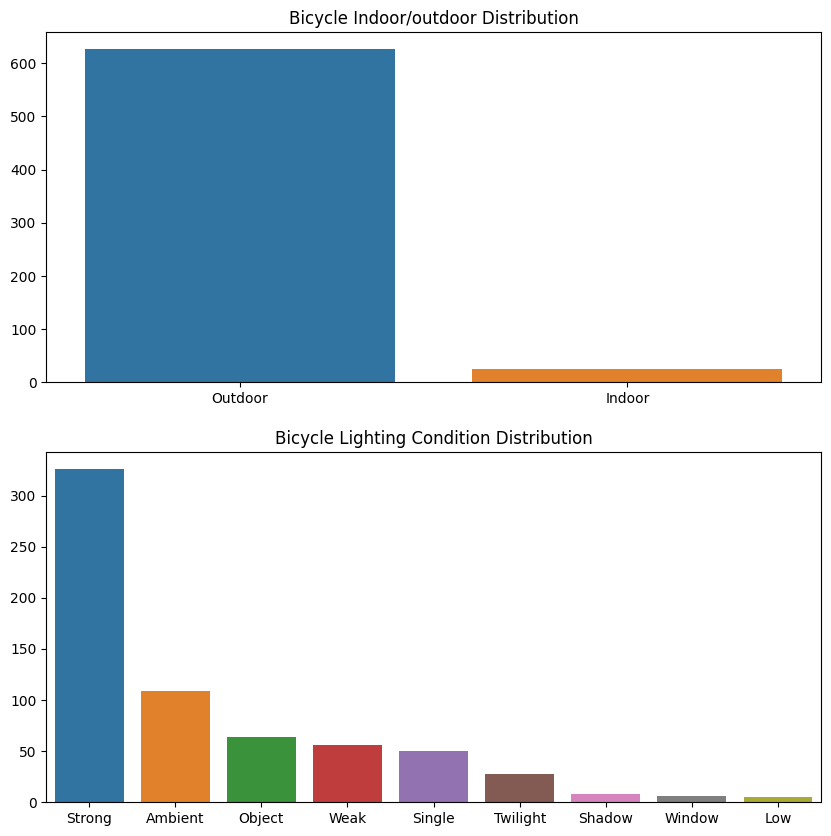

Boat In/Out Distribution: ['Outdoor', 'Indoor'] [676, 3]
Boat Lightning Condt Distribution: ['Strong', 'Twilight', 'Ambient', 'Weak', 'Single', 'Object', 'Shadow', 'Low'] [277, 254, 73, 38, 24, 5, 5, 3]


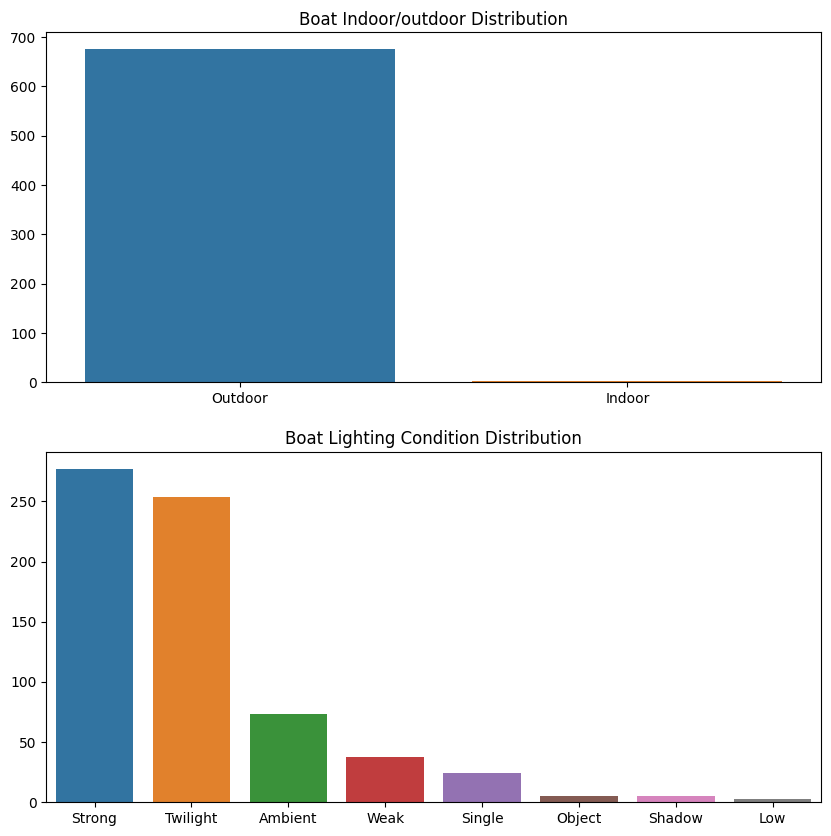

Bottle In/Out Distribution: ['Indoor', 'Outdoor'] [438, 109]
Bottle Lightning Condt Distribution: ['Ambient', 'Single', 'Weak', 'Object', 'Strong', 'Low', 'Screen', 'Window', 'Twilight', 'Shadow'] [172, 100, 65, 61, 59, 39, 30, 13, 6, 2]


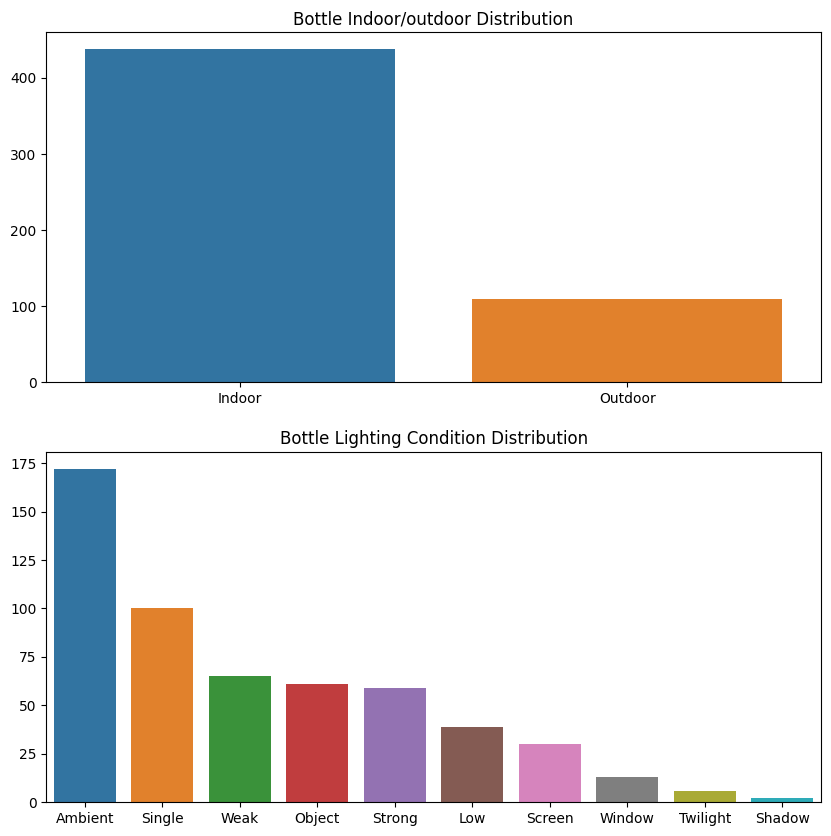

Bus In/Out Distribution: ['Outdoor', 'Indoor'] [522, 5]
Bus Lightning Condt Distribution: ['Strong', 'Weak', 'Ambient', 'Twilight', 'Object', 'Single', 'Shadow', 'Screen'] [314, 107, 42, 25, 19, 17, 2, 1]


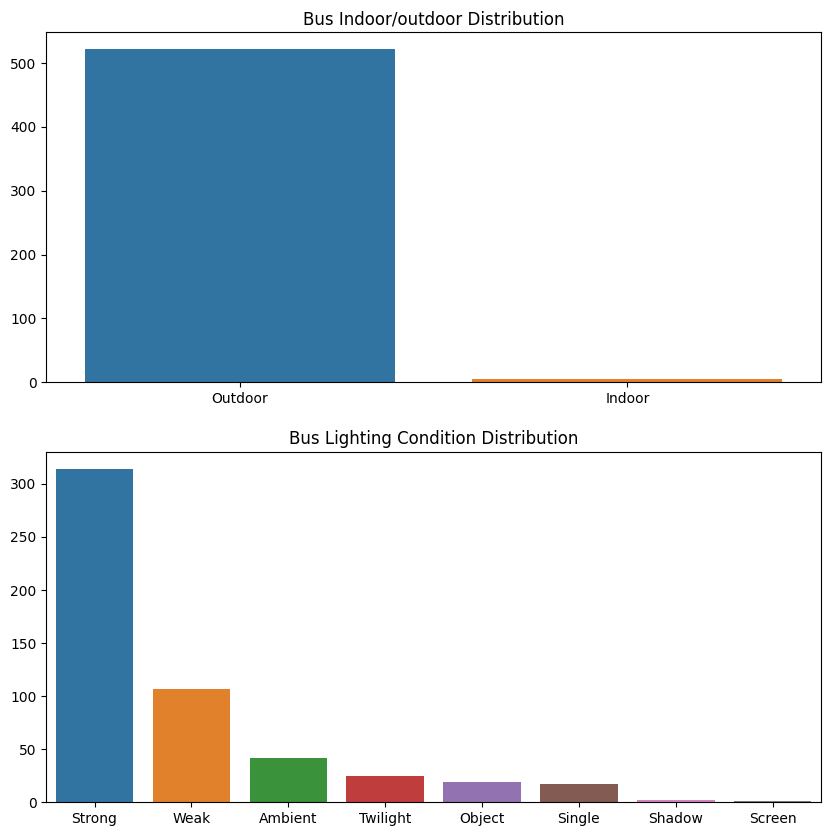

Car In/Out Distribution: ['Outdoor', 'Indoor'] [619, 19]
Car Lightning Condt Distribution: ['Strong', 'Ambient', 'Weak', 'Single', 'Twilight', 'Object', 'Low', 'Shadow'] [302, 121, 78, 59, 35, 24, 11, 8]


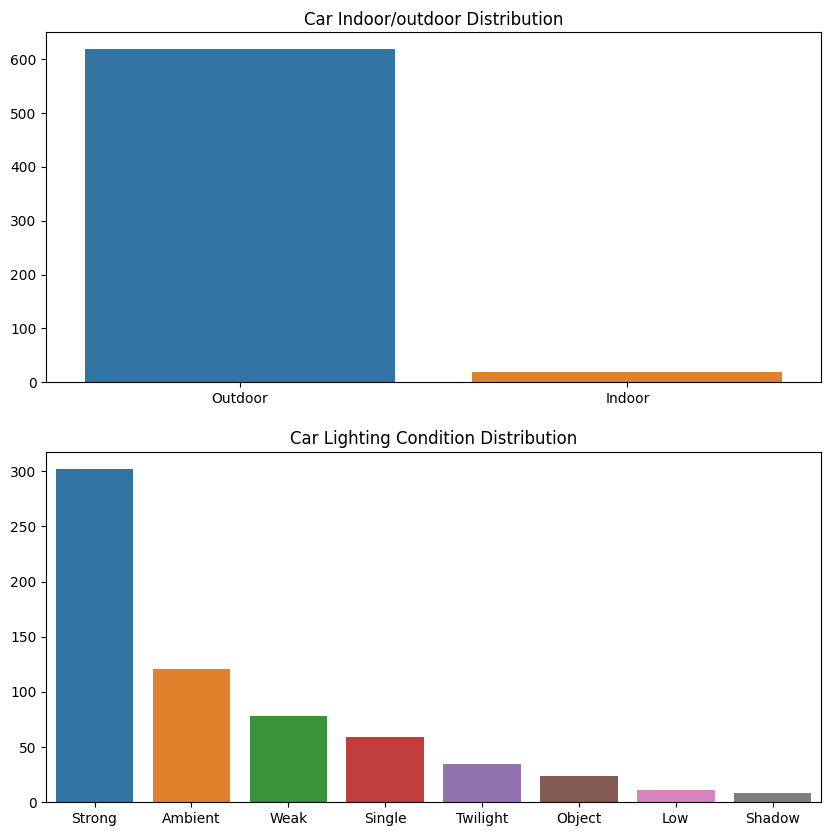

Cat In/Out Distribution: ['Indoor', 'Outdoor'] [422, 313]
Cat Lightning Condt Distribution: ['Ambient', 'Low', 'Single', 'Strong', 'Object', 'Window', 'Weak', 'Screen', 'Twilight', 'Shadow'] [404, 78, 60, 60, 51, 35, 20, 15, 8, 4]


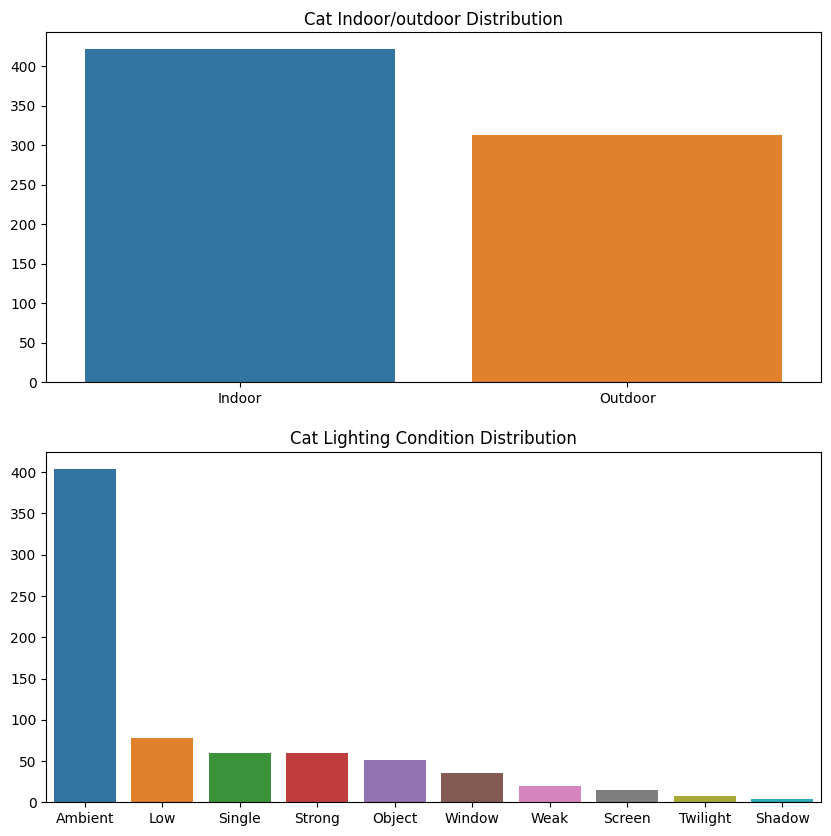

Chair In/Out Distribution: ['Indoor', 'Outdoor'] [496, 152]
Chair Lightning Condt Distribution: ['Ambient', 'Window', 'Single', 'Strong', 'Object', 'Screen', 'Weak', 'Low', 'Twilight', 'Shadow'] [188, 121, 90, 83, 48, 45, 43, 21, 6, 3]


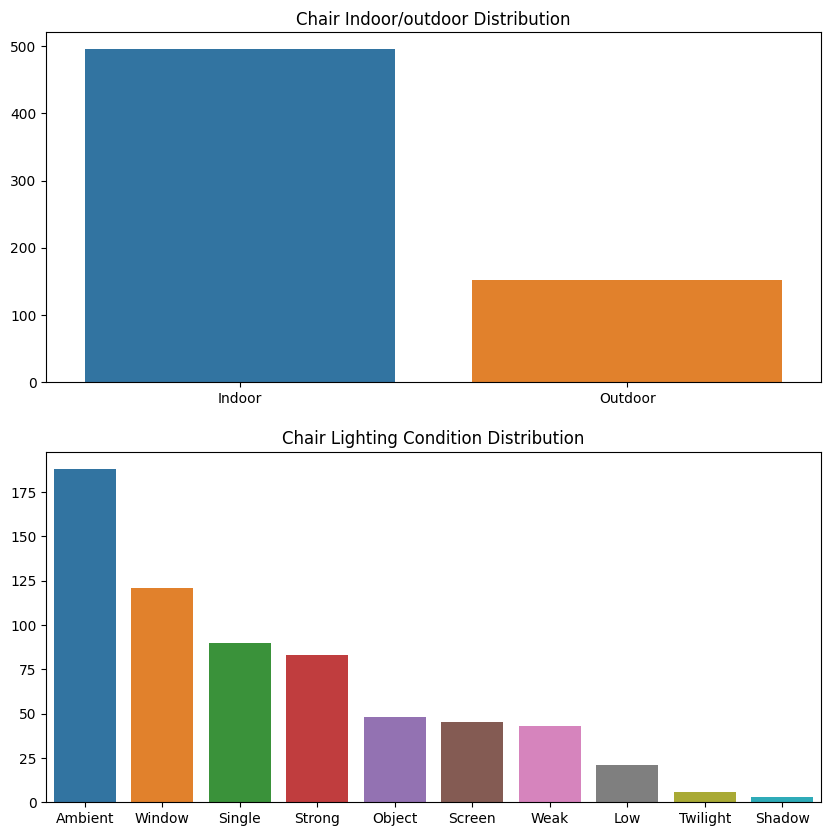

Cup In/Out Distribution: ['Indoor', 'Outdoor'] [486, 33]
Cup Lightning Condt Distribution: ['Ambient', 'Single', 'Weak', 'Screen', 'Object', 'Window', 'Strong', 'Low', 'Twilight', 'Shadow'] [228, 90, 47, 38, 37, 31, 30, 16, 1, 1]


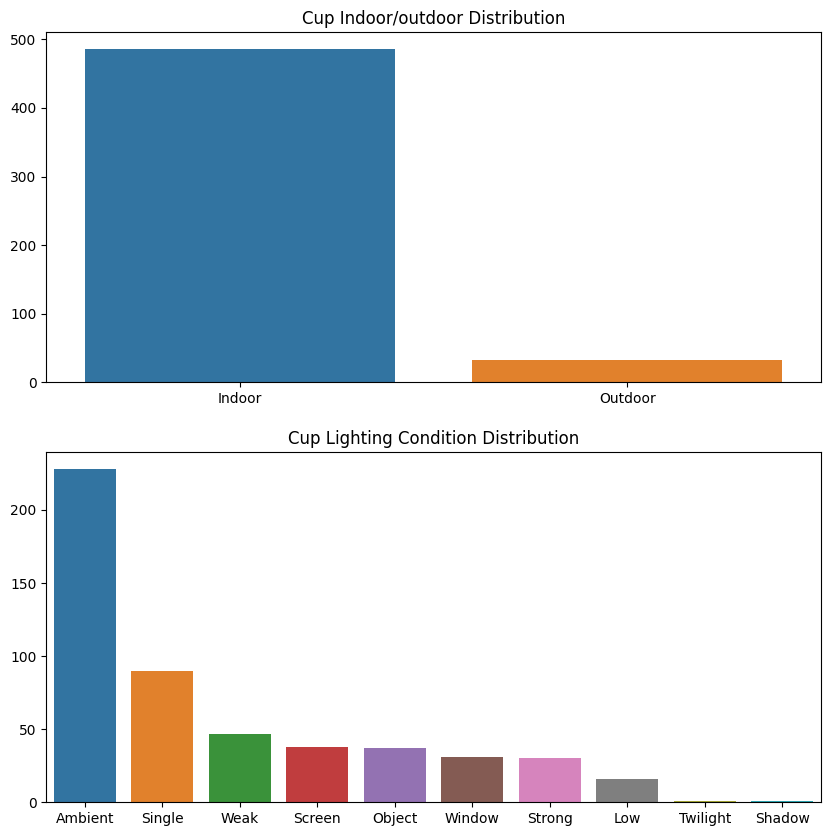

Dog In/Out Distribution: ['Outdoor', 'Indoor'] [505, 296]
Dog Lightning Condt Distribution: ['Ambient', 'Strong', 'Single', 'Object', 'Low', 'Weak', 'Window', 'Twilight', 'Shadow', 'Screen'] [419, 96, 75, 60, 42, 36, 34, 26, 7, 6]


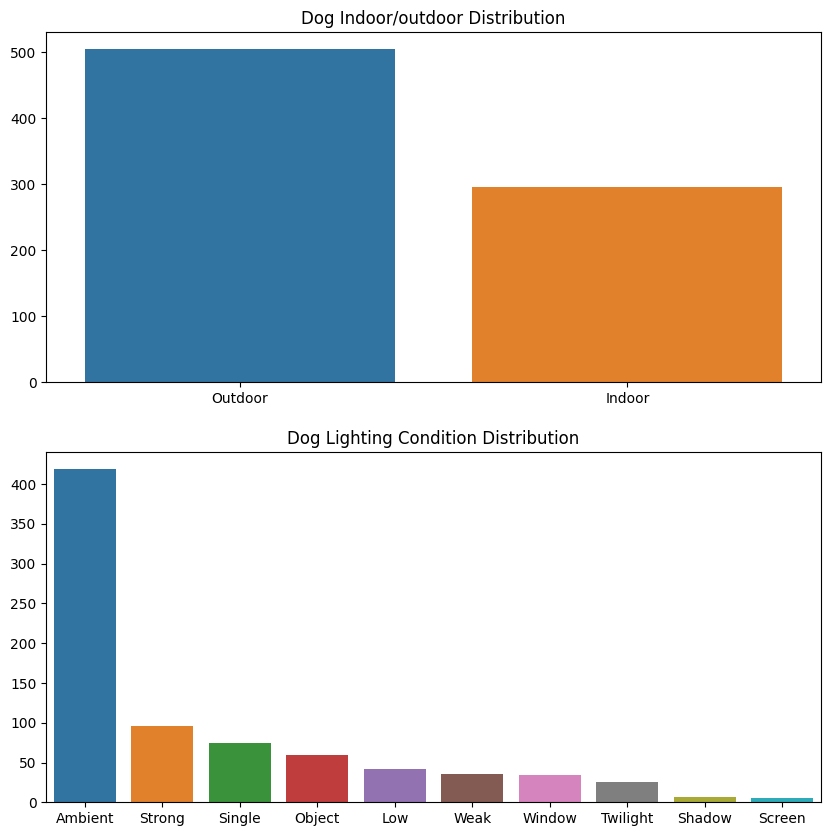

Motorbike In/Out Distribution: ['Outdoor', 'Indoor'] [486, 17]
Motorbike Lightning Condt Distribution: ['Strong', 'Ambient', 'Single', 'Weak', 'Object', 'Twilight', 'Shadow', 'Low'] [263, 94, 56, 44, 28, 14, 2, 2]


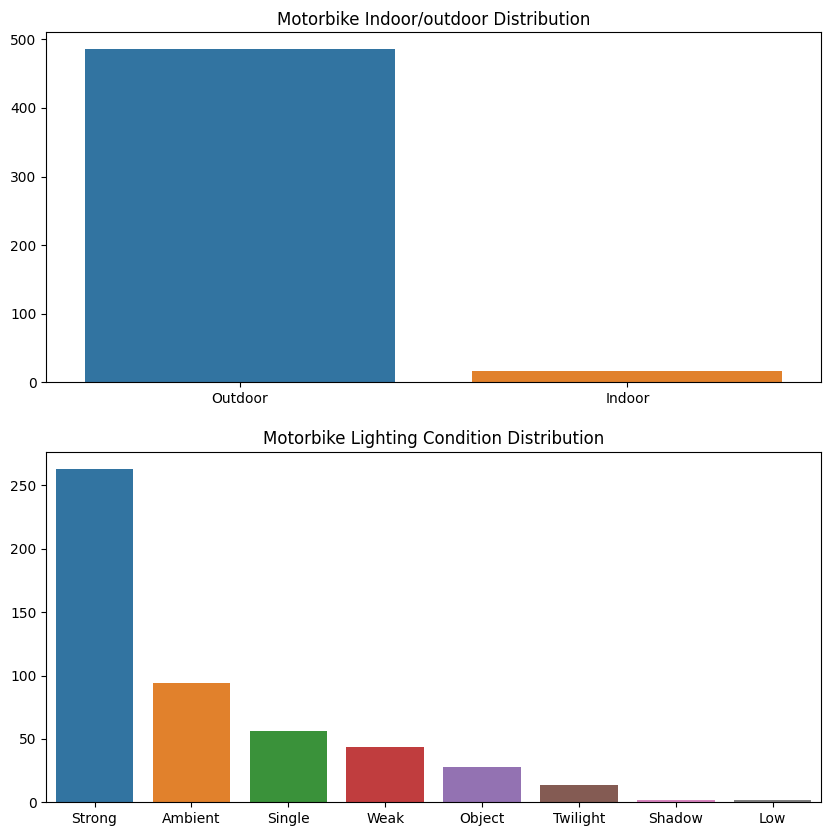

People In/Out Distribution: ['Outdoor', 'Indoor'] [396, 213]
People Lightning Condt Distribution: ['Strong', 'Ambient', 'Weak', 'Object', 'Single', 'Low', 'Window', 'Shadow', 'Twilight', 'Screen'] [181, 117, 101, 87, 73, 15, 14, 11, 8, 2]


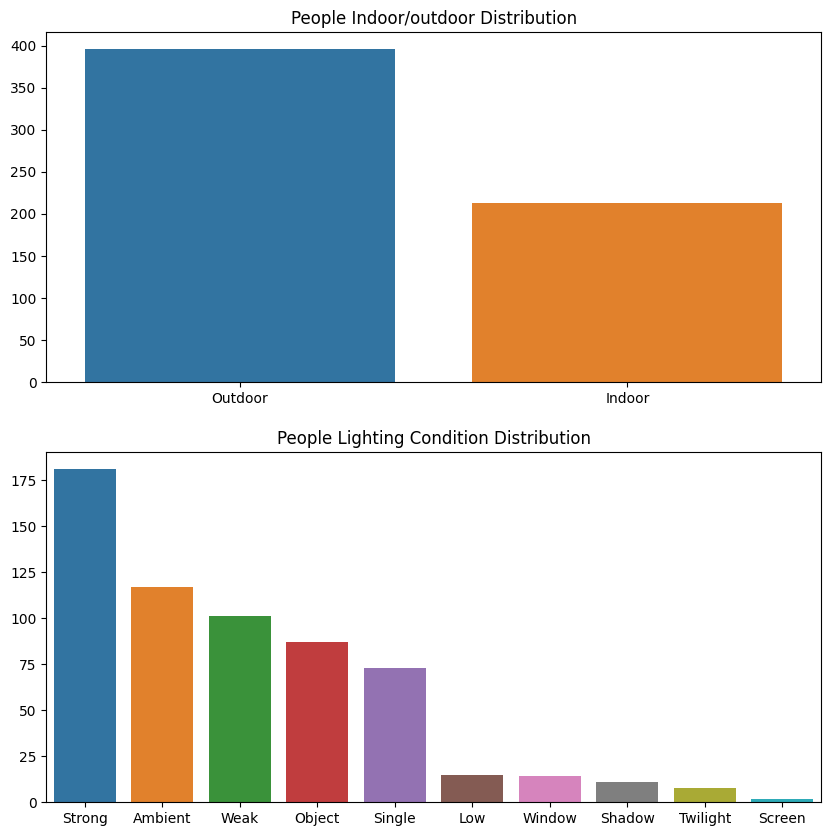

Table In/Out Distribution: ['Indoor', 'Outdoor'] [402, 103]
Table Lightning Condt Distribution: ['Ambient', 'Window', 'Weak', 'Single', 'Strong', 'Screen', 'Object', 'Low', 'Twilight', 'Shadow'] [131, 109, 70, 68, 68, 28, 14, 9, 5, 3]


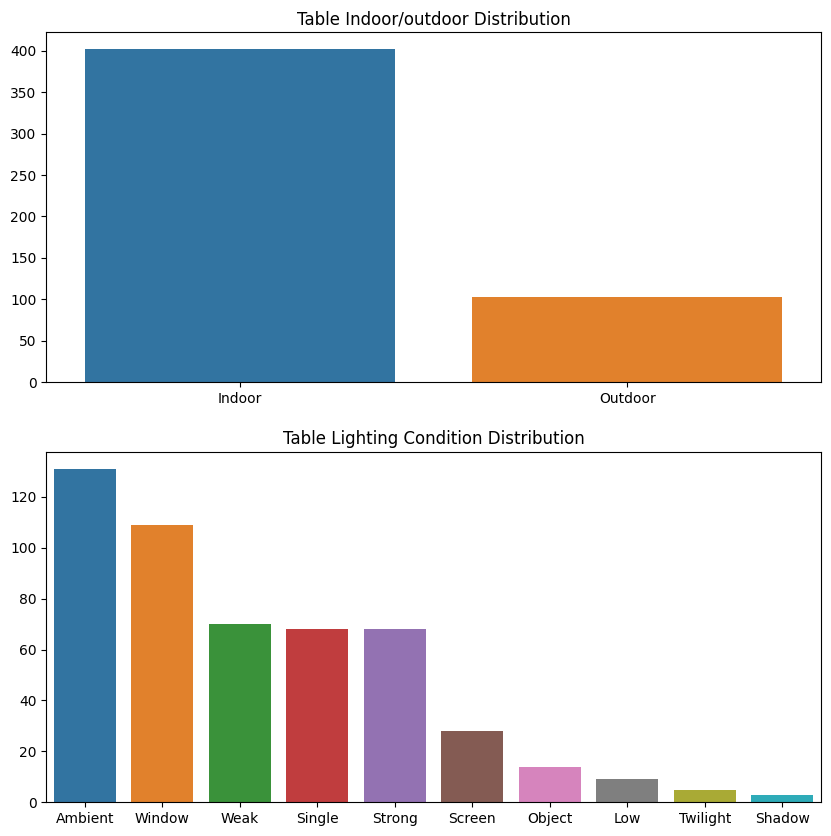

In [17]:
# global df


for label in class_dict.keys():
  df1 = df[df['Class']==label]
  in_out = dict(df1['In/Out'].value_counts())
  light_cond = dict(df1['Light'].value_counts())

  in_out_label =[]
  in_out_cnt =[]
  for i,j in in_out.items():
      in_out_label.append(in_out_dict[i])
      in_out_cnt.append(j)

  light_label = []
  light_cnt = []
  for i,j in light_cond.items():
      light_label.append(light_dict[i])
      light_cnt.append(j)

  print('{} In/Out Distribution:'.format(class_dict[label]),in_out_label,in_out_cnt)
  print('{} Lightning Condt Distribution:'.format(class_dict[label]),light_label,light_cnt)

  fig,axis = plt.subplots(2,1,figsize=(10,10))
  axis1 = sns.barplot(x=in_out_label,y=in_out_cnt,ax=axis[0])
  axis1.set_title('{} Indoor/outdoor Distribution'.format(class_dict[label]))
  axis2 = sns.barplot(x=light_label,y=light_cnt,ax=axis[1])
  axis2.set_title('{} Lighting Condition Distribution'.format(class_dict[label]))
  plt.show()

In [18]:
def plot_sample_images(label,n):
      images = []
      light = []
      global df
      df2 = df[df['Class']==label]

      for i in range(1,11):
          temp = list(df2[df2['Light']==i]['Name'])[0:n]
          if(len(temp)>2):
              for j in temp:
                  light.append(i)
                  images.append(j)

      fig, ax = plt.subplots(len(images)//n,n,figsize=(15,30),gridspec_kw={'wspace':0.01,'hspace':0.1})
      ax = ax.ravel()

      for i, img in enumerate(images):
          im_org = cv2.imread(img)
          try:
              im_resized = cv2.resize(im_org,(300,300),interpolation=cv2.INTER_LINEAR)
          except:
              continue
          ax[i].imshow(cv2.cvtColor(im_resized,cv2.COLOR_BGR2RGB),aspect='auto')
          ax[i].set_axis_off()
          ax[i].set_xlim(ax[i].get_xlim())
          ax[i].set_ylim(ax[i].get_ylim())
          ax[i].set_title(class_dict[label] + "/" + light_dict[light[i]])
      
      plt.show()

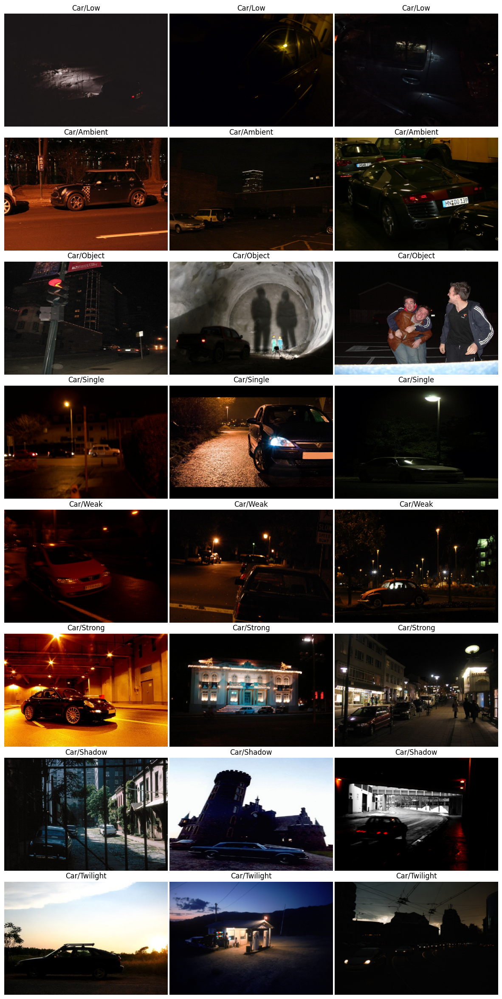

In [19]:
plot_sample_images(5,3)

In [20]:
# Prepared zip file w/ both images and annotation in one directory
!unzip "/content/drive/MyDrive/ExDark/exdark.zip"

Streaming output truncated to the last 5000 lines.
  inflating: exdark/2015_04864.jpg   
 extracting: exdark/2015_04864.jpg.txt  
  inflating: exdark/2015_04865.jpg   
 extracting: exdark/2015_04865.jpg.txt  
  inflating: exdark/2015_04866.jpg   
  inflating: exdark/2015_04866.jpg.txt  
  inflating: exdark/2015_04867.jpg   
 extracting: exdark/2015_04867.jpg.txt  
  inflating: exdark/2015_04868.jpg   
  inflating: exdark/2015_04868.jpg.txt  
  inflating: exdark/2015_04869.jpg   
  inflating: exdark/2015_04869.jpg.txt  
  inflating: exdark/2015_04870.jpg   
 extracting: exdark/2015_04870.jpg.txt  
  inflating: exdark/2015_04871.jpg   
  inflating: exdark/2015_04871.jpg.txt  
  inflating: exdark/2015_04872.jpg   
 extracting: exdark/2015_04872.jpg.txt  
  inflating: exdark/2015_04873.jpg   
  inflating: exdark/2015_04873.jpg.txt  
  inflating: exdark/2015_04874.jpg   
 extracting: exdark/2015_04874.jpg.txt  
  inflating: exdark/2015_04875.jpg   
 extracting: exdark/2015_04875.jpg.txt  
 

In [21]:
# Build Dataframe for this new combined directory
df_combined = pd.read_csv('/content/imageclasslist.txt',sep=' ',header=None,skiprows=1)
df_combined.columns = ['Name','Class','Light','In/Out','Train/Val/Test']

In [22]:
df_combined.head(5)

,Name,Class,Light,In/Out,Train/Val/Test
0,2015_00001.png,1,2,1,1
1,2015_00002.png,1,6,2,1
2,2015_00003.png,1,5,2,1
3,2015_00004.jpg,1,3,2,1
4,2015_00005.jpg,1,6,2,1


In [23]:
# /content/exdark/2015_00001.png

In [24]:
# df_combined['Name'] = '/content/exdark/' + df_combined['Name']

In [25]:
df_combined.head(5)

,Name,Class,Light,In/Out,Train/Val/Test
0,2015_00001.png,1,2,1,1
1,2015_00002.png,1,6,2,1
2,2015_00003.png,1,5,2,1
3,2015_00004.jpg,1,3,2,1
4,2015_00005.jpg,1,6,2,1


In [26]:
print(df_combined["Light"].unique())

[ 2  6  5  3 10  4  9  8  1  7]


In [27]:
light_counts = df_combined["Light"].value_counts()

print(light_counts)

2     2098
6     2059
4      762
5      705
3      498
10     416
8      363
1      241
7      165
9       56
Name: Light, dtype: int64


In [28]:
import os
import shutil
import pandas as pd

# images are currently located
image_directory = '/content/exdark/'

# new directory
new_directory = '/content/exdark_split_light'

# Create the new directory if it doesn't exist
if not os.path.exists(new_directory):
    os.makedirs(new_directory)
    os.makedirs(os.path.join(new_directory, 'train')) # create 'train' directory

# Loop through the dataframe and copy the images
light_counts = df['Light'].value_counts()
dropped_light_dict = {
    1: 'dropped',
    7: 'dropped',
    9: 'dropped'
}

for light, count in light_counts.items():
    if light in dropped_light_dict:
        continue
    
    subdirectory_path = os.path.join(new_directory, light_dict[light])
    
    if not os.path.exists(subdirectory_path):
        os.makedirs(subdirectory_path)
        
    copied = 0
    light_copied = 0  # track number of images copied for this light condition
    for index, row in df.iterrows():
        if row['Light'] != light:
            continue
        
        # Extract the filename
        filename = os.path.basename(row['Name'])
        
        img_path = os.path.join(image_directory, filename)
        
        img_name, img_ext = os.path.splitext(filename)
        txt_files = [f for f in os.listdir(image_directory) if f.startswith(img_name) and f.endswith('.txt')]
        if len(txt_files) > 0:
            txt_file = txt_files[0]
            txt_path = os.path.join(image_directory, txt_file)
          
            if copied < 200:
                destination_path = os.path.join(new_directory, 'train')
            else:
                destination_path = subdirectory_path
            shutil.copy(img_path, destination_path)
            shutil.copy(txt_path, destination_path)
            copied += 1
            light_copied += 1
            
        if copied >= 250:
            break
    
    print(f"Copied {light_copied} images for light condition {light}")


Copied 250 images for light condition 2
Copied 250 images for light condition 6
Copied 250 images for light condition 4
Copied 250 images for light condition 5
Copied 250 images for light condition 3
Copied 250 images for light condition 10
Copied 250 images for light condition 8


In [29]:
import os

base_directory = '/content/exdark_split_light'

for directory in os.listdir(base_directory):
    if os.path.isdir(os.path.join(base_directory, directory)):
        count = len(os.listdir(os.path.join(base_directory, directory)))
        print(f"{directory}: {count} files")

Object: 100 files
Ambient: 100 files
Window: 100 files
train: 2800 files
Twilight: 100 files
Weak: 100 files
Strong: 100 files
Single: 100 files


In [30]:
# Creating Artificially Dark Dataset with Gamma Correction
# Reference: https://pyimagesearch.com/2015/10/05/opencv-gamma-correction/

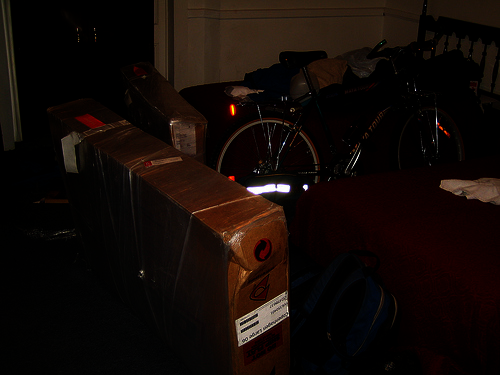

In [31]:
import numpy as np
import cv2
from google.colab.patches import cv2_imshow

# also known as power law trasnform

original = cv2.imread('/content/exdark/2015_00001.png')

gamma = 0.5 # fairly dark value
gamma_coef = 1.0 / gamma
# table is constructed to map every pixel val to the corrected val
table = np.array([((i / 255.0) ** gamma_coef) * 255
  for i in np.arange(0, 256)]).astype("uint8") # have to cast as floats dont work

# apply gamma correction
adjusted = cv2.LUT(original, table)
cv2_imshow(adjusted)

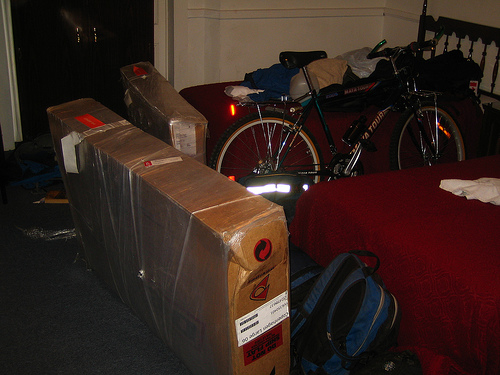

In [32]:
cv2_imshow(original)

In [44]:
cv2.imwrite('bike_dark_adjusted.jpg', adjusted)
cv2.imwrite('bike_norm.jpg', original)

True

In [33]:
# for all these lighting condition test need a baseline
import os
import random
import shutil
# Define the path to the input directory
input_dir = '/content/exdark'

# Define the paths to the output directories
train_dir = '/content/base/train'
test_dir = '/content/base/test'

if not os.path.exists(train_dir):
    os.makedirs(train_dir)

if not os.path.exists(test_dir):
    os.makedirs(test_dir)

# Get a list of all image files in the input directory
img_files = [f for f in os.listdir(input_dir) if not f.endswith('.txt') and os.path.isfile(os.path.join(input_dir, f))]

# Shuffle the list of image files
random.shuffle(img_files)

# Take the first 400 images and save them to the train directory
for img_file in img_files[:400]:

   # Construct the full path to the input file
    input_path = os.path.join(input_dir, img_file)

    img_name, img_ext = os.path.splitext(img_file)

    txt_files = [f for f in os.listdir(input_dir) if f.startswith(img_name) and f.endswith('.txt')]
    if len(txt_files) > 0:
        txt_file = txt_files[0]
        txt_path = os.path.join(input_dir, txt_file)

        shutil.copy(input_path, train_dir)
        shutil.copy(txt_path, train_dir)
  



# Take the next 100 images and save them to the test directory
for img_file in img_files[400:500]:
       # Construct the full path to the input file
    input_path = os.path.join(input_dir, img_file)

    img_name, img_ext = os.path.splitext(img_file)

    txt_files = [f for f in os.listdir(input_dir) if f.startswith(img_name) and f.endswith('.txt')]
    if len(txt_files) > 0:
        txt_file = txt_files[0]
        txt_path = os.path.join(input_dir, txt_file)

        shutil.copy(input_path, test_dir)
        shutil.copy(txt_path, test_dir)
  



In [34]:
import os

base_directory = '/content/base'

for directory in os.listdir(base_directory):
    if os.path.isdir(os.path.join(base_directory, directory)):
        count = len(os.listdir(os.path.join(base_directory, directory)))
        print(f"{directory}: {count} files")

test: 200 files
train: 800 files


In [35]:
# Darken images

# Define the path to the input directory
input_dir = '/content/base/train'

# Define the path to the output directory
output_dir = '/content/exdark_dark/train'

# Create the output directory if it doesn't already exist
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

# Get a list of all image files
img_files = [f for f in os.listdir(input_dir) if not f.endswith('.txt') and os.path.isfile(os.path.join(input_dir, f))]

# Loop through all files in the input directory
for filename in img_files:
    
    # Construct the full path to the input file
    input_path = os.path.join(input_dir, filename)

    img_name, img_ext = os.path.splitext(filename)
    
    # Read in the image
    image = cv2.imread(input_path)
    
    # Apply gamma correction with a gamma value of 0.5
    gamma = 0.5

    inv_gamma = 1.0 / gamma
    table = np.array([((i / 255.0) ** inv_gamma) * 255 for i in np.arange(0, 256)]).astype("uint8")
    corrected = cv2.LUT(image, table)
    
    # Construct the full path to the output file
    output_path = os.path.join(output_dir, filename)

    txt_files = [f for f in os.listdir(input_dir) if f.startswith(img_name) and f.endswith('.txt')]
    if len(txt_files) > 0:
        txt_file = txt_files[0]
        txt_path = os.path.join(input_dir, txt_file)

        # Save the adjusted image to the output directory
        cv2.imwrite(output_path, corrected)

        shutil.copy(txt_path, output_dir)
    else:
      print("error" + filename)
    
    

    

In [36]:
# Define the path to the input directory
input_dir = '/content/base/test'

# Define the path to the output directory
output_dir = '/content/exdark_dark/test'

# Create the output directory if it doesn't already exist
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

# Get a list of all image files
img_files = [f for f in os.listdir(input_dir) if not f.endswith('.txt') and os.path.isfile(os.path.join(input_dir, f))]

# Loop through all files in the input directory
for filename in img_files:
    
    # Construct the full path to the input file
    input_path = os.path.join(input_dir, filename)

    img_name, img_ext = os.path.splitext(filename)
    
    # Read in the image
    image = cv2.imread(input_path)
    
    # Apply gamma correction with a gamma value of 0.5
    gamma = 0.5

    inv_gamma = 1.0 / gamma
    table = np.array([((i / 255.0) ** inv_gamma) * 255 for i in np.arange(0, 256)]).astype("uint8")
    corrected = cv2.LUT(image, table)
    
    # Construct the full path to the output file
    output_path = os.path.join(output_dir, filename)

    txt_files = [f for f in os.listdir(input_dir) if f.startswith(img_name) and f.endswith('.txt')]
    if len(txt_files) > 0:
        txt_file = txt_files[0]
        txt_path = os.path.join(input_dir, txt_file)

        # Save the adjusted image to the output directory
        cv2.imwrite(output_path, corrected)

        shutil.copy(txt_path, output_dir)
    else:
      print("error" + filename)

In [37]:
import os

base_directory = '/content/exdark_dark'

for directory in os.listdir(base_directory):
    if os.path.isdir(os.path.join(base_directory, directory)):
        count = len(os.listdir(os.path.join(base_directory, directory)))
        print(f"{directory}: {count} files")

test: 200 files
train: 800 files


In [38]:
# experiemnt with enhancing the dark images with Multi-Scale Retinex
# referenced this blog and tweaked the code for Retinex
# https://santhalakshminarayana.github.io/blog/retinex-image-enhancement

In [39]:
!pip install opencv-python-headless

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [40]:
# function that does gamma correction as above using the lookup table with adjusted vals by power law
def adjust_gamma(image, gamma=1.0):

    invGamma = 1.0 / gamma
    table = (np.arange(0, 256) / 255.0) ** invGamma * 255
    table = np.clip(table, 0, 255).astype(np.uint8)

    return cv2.LUT(image, table)

In [41]:
# This function is the pipeline to enhance/brighten the low-light image
# import numba as nb

# @nb.njit(parallel=True)
def msr_sigma(sigma, gray, eps):
    # Compute the logarithm of the grayscale image and the blurred image for the current sigma value (SSR)
    return np.log10(gray) - np.log10(cv2.GaussianBlur(gray, (0, 0), sigma) + eps)

def enhance_image(image_path, gamma=1.0):

    # load the image
    image = cv2.imread(image_path)

    # convert it to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # set any zero vals to 1 toa void divide by zero
    gray[gray == 0] = 1

    # apply gamma correction to enhance image using input gamma arg (1.5)
    adjusted = adjust_gamma(gray, gamma=gamma)

    # apply histogram equalization to enhance contrast
    equalized = cv2.equalizeHist(adjusted)

    # apply multi-scale retinex algorithm to enhance brightness

    # Define a list of sigma values for Gaussian blur
    sigma_scales = [15, 80, 250]

    # Initialize an array of zeros to hold the multi-scale retinex algorithm (MSR) output
    msr = np.zeros(gray.shape)

    eps = 1e-8  # a very small constant value to avoid divide by zero errors

    # get the MSR output for each sigma value
    for sigma in sigma_scales:
        msr += msr_sigma(sigma, gray, eps)

    # average MSR output over all sigma values
    msr = msr / len(sigma_scales)

    # Normalize the MSR output to the range [0, 255] and convert it to an 8-bit unsigned integer image
    msr = cv2.normalize(msr, None, 0, 255, cv2.NORM_MINMAX)
    msr = msr.astype(np.uint8)
    enhanced = cv2.cvtColor(msr, cv2.COLOR_GRAY2BGR)

    # blend the enhanced image with the original image with alpha blending
    alpha = 0.5
    beta = 1 - alpha
    blended = cv2.addWeighted(image, alpha, enhanced, beta, 0)

    return blended

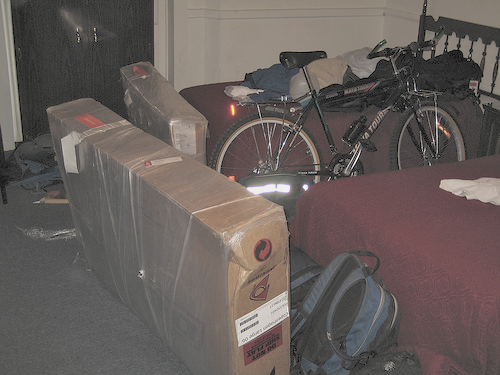

In [43]:
result = enhance_image('/content/exdark/2015_00001.png', gamma=1.5)
cv2_imshow(result)

In [45]:
cv2.imwrite('bike_our_enhance.jpg', result)

True

In [49]:
# Brighten images

from tqdm import tqdm

import random

# Define the path to the input directory
input_dir = '/content/base/train'

# Define the path to the output directory
output_dir = '/content/exdark_bright/train'

# Create the output directory if it doesn't already exist
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

# Get a list of all image files
img_files = [f for f in os.listdir(input_dir) if not f.endswith('.txt') and os.path.isfile(os.path.join(input_dir, f))]

# Loop through all files in the input directory
for filename in tqdm(img_files, desc='Processing images'):
    
    # Construct the full path to the input file
    input_path = os.path.join(input_dir, filename)

    img_name, img_ext = os.path.splitext(filename)
  
    
    corrected = enhance_image(input_path, gamma=1.5)
    
    # Construct the full path to the output file
    output_path = os.path.join(output_dir, filename)

    txt_files = [f for f in os.listdir(input_dir) if f.startswith(img_name) and f.endswith('.txt')]
    if len(txt_files) > 0:
        txt_file = txt_files[0]
        txt_path = os.path.join(input_dir, txt_file)

        # Save the adjusted image to the output directory
        cv2.imwrite(output_path, corrected)

        shutil.copy(txt_path, output_dir)
    else:
      print("error" + filename)

Processing images: 100%|██████████| 400/400 [1:02:12<00:00,  9.33s/it]


In [50]:
# Brighten images

from tqdm import tqdm

import random

# Define the path to the input directory
input_dir = '/content/base/test'

# Define the path to the output directory
output_dir = '/content/exdark_bright/test'

# Create the output directory if it doesn't already exist
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

# Get a list of all image files
img_files = [f for f in os.listdir(input_dir) if not f.endswith('.txt') and os.path.isfile(os.path.join(input_dir, f))]

# Loop through all files in the input directory
for filename in tqdm(img_files, desc='Processing images'):
    
    # Construct the full path to the input file
    input_path = os.path.join(input_dir, filename)

    img_name, img_ext = os.path.splitext(filename)
  
    corrected = enhance_image(input_path, gamma=1.5)
    
    # Construct the full path to the output file
    output_path = os.path.join(output_dir, filename)

    txt_files = [f for f in os.listdir(input_dir) if f.startswith(img_name) and f.endswith('.txt')]
    if len(txt_files) > 0:
        txt_file = txt_files[0]
        txt_path = os.path.join(input_dir, txt_file)

        # Save the adjusted image to the output directory
        cv2.imwrite(output_path, corrected)

        shutil.copy(txt_path, output_dir)
    else:
      print("error" + filename)

Processing images: 100%|██████████| 100/100 [17:35<00:00, 10.56s/it]


In [51]:
!zip -r /content/images_bright.zip /content/exdark_bright

  adding: content/exdark_bright/ (stored 0%)
  adding: content/exdark_bright/test/ (stored 0%)
  adding: content/exdark_bright/test/2015_03140.jpg (deflated 0%)
  adding: content/exdark_bright/test/2015_03493.jpg.txt (deflated 18%)
  adding: content/exdark_bright/test/2015_01323.png.txt (deflated 46%)
  adding: content/exdark_bright/test/2015_00291.jpg.txt (deflated 19%)
  adding: content/exdark_bright/test/2015_03137.jpg.txt (deflated 18%)
  adding: content/exdark_bright/test/2015_04983.jpg.txt (deflated 39%)
  adding: content/exdark_bright/test/2015_04973.jpg.txt (deflated 26%)
  adding: content/exdark_bright/test/2015_06870.jpg (deflated 0%)
  adding: content/exdark_bright/test/2015_00329.jpg.txt (deflated 27%)
  adding: content/exdark_bright/test/2015_00722.jpg (deflated 1%)
  adding: content/exdark_bright/test/2015_07345.png (deflated 6%)
  adding: content/exdark_bright/test/2015_00780.jpg (deflated 0%)
  adding: content/exdark_bright/test/2015_05955.jpg.txt (deflated 58%)
  addin

In [45]:
!unzip '/content/images_bright.zip' -d "/"

Archive:  /content/images_bright.zip
   creating: /content/exdark_bright/
  inflating: /content/exdark_bright/2015_02114.jpg  
  inflating: /content/exdark_bright/2015_05283.jpg  
  inflating: /content/exdark_bright/2015_02739.jpg  
  inflating: /content/exdark_bright/2015_05144.jpg  
  inflating: /content/exdark_bright/2015_04106.jpg  
  inflating: /content/exdark_bright/2015_03193.jpg  
  inflating: /content/exdark_bright/2015_03498.jpg  
  inflating: /content/exdark_bright/2015_00791.jpg  
  inflating: /content/exdark_bright/2015_00889.jpg  
  inflating: /content/exdark_bright/2015_07138.jpg  
  inflating: /content/exdark_bright/2015_01370.jpg  
  inflating: /content/exdark_bright/2015_06037.jpg  
  inflating: /content/exdark_bright/2015_00496.jpg  
  inflating: /content/exdark_bright/2015_04249.jpg  
  inflating: /content/exdark_bright/2015_06208.png  
  inflating: /content/exdark_bright/2015_06554.jpg  
  inflating: /content/exdark_bright/2015_01608.jpg  
  inflating: /content/exd

In [52]:
# Going to try and enhance images using Mirenet
# Referenced / tweaked this notebook on kaggle:
# https://www.kaggle.com/code/nulldata/low-light-image-enhancement-with-keras-mirnet

In [53]:
! pip install keras
! pip install huggingface_hub

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 224.5/224.5 kB 20.7 MB/s eta 0:00:00


In [54]:
import PIL
from PIL import Image 
from huggingface_hub import from_pretrained_keras 
import keras
from keras.utils import load_img, img_to_array

In [55]:
mirnet_model = from_pretrained_keras("keras-io/lowlight-enhance-mirnet", compile=False)

config.json not found in HuggingFace Hub.


Fetching 11 files:   0%|          | 0/11 [00:00<?, ?it/s]

In [56]:
low_light_img = Image.open('/content/exdark/2015_00001.png').convert('RGB')
low_light_img = low_light_img.resize((1024,1024),Image.LANCZOS)
image = img_to_array(low_light_img)
image = image.astype('float32') / 255.0
image = np.expand_dims(image, axis = 0)
output = mirnet_model.predict(image) # model inference to enhance the low light 
output_image = output[0] * 255.0
output_image = output_image.clip(0,255)
output_image = output_image.reshape((np.shape(output_image)[0],np.shape(output_image)[1],3))
output_image = np.uint32(output_image)
final_image = (Image.fromarray(output_image.astype('uint8'),'RGB')).resize((500,375),Image.LANCZOS)
final_image.save("bike_mir_enhance.jpg")

1/1 [==============================] - 13s 13s/step


In [94]:
# input_dir = '/content/exdark'
# img_files = [f for f in os.listdir(input_dir) if not f.endswith('.txt') and os.path.isfile(os.path.join(input_dir, f))]
# # Get the first 500 images
# img_files = img_files[:500]

# # Initialize max width and height to zero
# max_width = 0
# max_height = 0

# # Iterate over the images and get the maximum width and height
# for img_file in img_files:
#     img_path = os.path.join(input_dir, img_file)
#     with Image.open(img_path) as img:
#         width, height = img.size
#         print(img.size)
#         if width > max_width:
#             max_width = width
#         if height > max_height:
#             max_height = height

# max_size = (max_width, max_height)
# print(f"The maximum size of the first 500 images is {max_size}")

(640, 480)
(640, 480)
(900, 675)
(637, 397)
(640, 427)
(500, 375)
(949, 841)
(500, 375)
(509, 339)
(500, 240)
(640, 427)
(1600, 1062)
(750, 1000)
(536, 800)
(1920, 1072)
(640, 426)
(480, 640)
(640, 427)
(500, 375)
(414, 414)
(640, 480)
(500, 375)
(640, 480)
(1095, 730)
(640, 426)
(900, 600)
(427, 640)
(640, 425)
(397, 297)
(1095, 730)
(375, 500)
(640, 427)
(1024, 683)
(480, 360)
(335, 511)
(640, 358)
(500, 375)
(500, 375)
(2291, 1527)
(900, 602)
(500, 236)
(600, 450)
(500, 375)
(730, 1095)
(1024, 683)
(640, 427)
(640, 427)
(720, 514)
(900, 672)
(375, 500)
(507, 338)
(720, 404)
(1024, 768)
(640, 426)
(507, 338)
(600, 450)
(477, 358)
(2448, 3264)
(338, 507)
(524, 327)
(640, 480)
(774, 1032)
(1024, 683)
(1024, 625)
(600, 800)
(319, 352)
(1024, 576)
(500, 375)
(375, 500)
(1279, 647)
(500, 375)
(900, 600)
(640, 482)
(696, 454)
(507, 337)
(1599, 874)
(640, 426)
(640, 429)
(500, 375)
(1280, 532)
(1600, 1509)
(1024, 664)
(640, 480)
(640, 480)
(2448, 3264)
(500, 332)
(337, 507)
(338, 507)
(777,

In [57]:
# Enhance images with Mirnet

# Define the path to the input directory
input_dir = '/content/base/train'

# Define the path to the output directory
output_dir = '/content/exdark_bright_mirnet/train'

from tqdm import tqdm
import random

# Create the output directory if it doesn't already exist
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

# Get a list of all image files
img_files = [f for f in os.listdir(input_dir) if not f.endswith('.txt') and os.path.isfile(os.path.join(input_dir, f))]

# Loop through all files in the input directory
for filename in tqdm(img_files, desc='Processing images'):
    
    # Construct the full path to the input file
    input_path = os.path.join(input_dir, filename)

    img_name, img_ext = os.path.splitext(filename)
    
    # Read in the image
    input_image = Image.open(input_path).convert('RGB')
    #save height width
    input_width, input_height = input_image.size
    # resize to set size
    input_image = input_image.resize((1024,1024),Image.LANCZOS)
    # convert image to np array
    image = img_to_array(input_image)
    # get betwenn 0 and 1
    image = image.astype('float32') / 255.0
    # batch of 1
    image = np.expand_dims(image, axis = 0)
    # predict inference
    output = mirnet_model.predict(image) 

    # 0 to 255
    output_image = output[0] * 255.0
    output_image = output_image.clip(0,255)
    # reshape
    output_image = output_image.reshape((np.shape(output_image)[0],np.shape(output_image)[1],3))
    # back to int
    output_image = np.uint32(output_image)

    output_image = (Image.fromarray(output_image.astype('uint8'),'RGB'))
    output_image = output_image.resize((input_width,input_height),Image.LANCZOS)
    
    
    # Construct the full path to the output file
    output_path = os.path.join(output_dir, filename)

    txt_files = [f for f in os.listdir(input_dir) if f.startswith(img_name) and f.endswith('.txt')]
    if len(txt_files) > 0:
        txt_file = txt_files[0]
        txt_path = os.path.join(input_dir, txt_file)

        # Save the adjusted image to the output directory
        output_image.save(output_path)

        shutil.copy(txt_path, output_dir)
    else:
      print("error" + filename)

Processing images:   0%|          | 0/400 [00:00<?, ?it/s]

1/1 [==============================] - 0s 357ms/step


Processing images:   0%|          | 1/400 [00:00<05:31,  1.20it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:   0%|          | 2/400 [00:01<05:03,  1.31it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:   1%|          | 3/400 [00:02<04:53,  1.35it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:   1%|          | 4/400 [00:02<04:49,  1.37it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:   1%|▏         | 5/400 [00:03<04:47,  1.38it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:   2%|▏         | 6/400 [00:04<04:45,  1.38it/s]

1/1 [==============================] - 0s 354ms/step


Processing images:   2%|▏         | 7/400 [00:05<04:52,  1.35it/s]

1/1 [==============================] - 0s 358ms/step


Processing images:   2%|▏         | 8/400 [00:05<04:47,  1.36it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:   2%|▏         | 9/400 [00:06<04:43,  1.38it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:   2%|▎         | 10/400 [00:07<04:43,  1.37it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:   3%|▎         | 11/400 [00:08<04:40,  1.38it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:   3%|▎         | 12/400 [00:09<05:51,  1.10it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:   3%|▎         | 13/400 [00:10<05:30,  1.17it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:   4%|▎         | 14/400 [00:10<05:15,  1.22it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:   4%|▍         | 15/400 [00:11<05:04,  1.26it/s]

1/1 [==============================] - 0s 354ms/step


Processing images:   4%|▍         | 16/400 [00:12<04:56,  1.29it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:   4%|▍         | 17/400 [00:13<04:55,  1.30it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:   4%|▍         | 18/400 [00:13<04:47,  1.33it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:   5%|▍         | 19/400 [00:14<04:43,  1.34it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:   5%|▌         | 20/400 [00:15<04:51,  1.31it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:   5%|▌         | 21/400 [00:16<04:44,  1.33it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:   6%|▌         | 22/400 [00:16<04:38,  1.36it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:   6%|▌         | 23/400 [00:17<04:36,  1.36it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:   6%|▌         | 24/400 [00:18<04:36,  1.36it/s]

1/1 [==============================] - 0s 359ms/step


Processing images:   6%|▋         | 25/400 [00:19<06:21,  1.02s/it]

1/1 [==============================] - 0s 353ms/step


Processing images:   6%|▋         | 26/400 [00:20<05:48,  1.07it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:   7%|▋         | 27/400 [00:21<05:23,  1.15it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:   7%|▋         | 28/400 [00:22<05:04,  1.22it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:   7%|▋         | 29/400 [00:22<04:52,  1.27it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:   8%|▊         | 30/400 [00:23<04:44,  1.30it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:   8%|▊         | 31/400 [00:24<04:39,  1.32it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:   8%|▊         | 32/400 [00:24<04:34,  1.34it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:   8%|▊         | 33/400 [00:26<05:14,  1.17it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:   8%|▊         | 34/400 [00:26<05:05,  1.20it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:   9%|▉         | 35/400 [00:27<04:50,  1.26it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:   9%|▉         | 36/400 [00:28<04:41,  1.29it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:   9%|▉         | 37/400 [00:29<04:36,  1.31it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  10%|▉         | 38/400 [00:29<04:34,  1.32it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  10%|▉         | 39/400 [00:30<04:28,  1.34it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  10%|█         | 40/400 [00:31<04:24,  1.36it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  10%|█         | 41/400 [00:31<04:21,  1.37it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  10%|█         | 42/400 [00:32<04:24,  1.35it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  11%|█         | 43/400 [00:33<04:28,  1.33it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  11%|█         | 44/400 [00:34<04:22,  1.35it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  11%|█▏        | 45/400 [00:34<04:19,  1.37it/s]

1/1 [==============================] - 0s 354ms/step


Processing images:  12%|█▏        | 46/400 [00:36<05:20,  1.10it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  12%|█▏        | 47/400 [00:36<05:00,  1.18it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  12%|█▏        | 48/400 [00:37<04:47,  1.23it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  12%|█▏        | 49/400 [00:38<04:36,  1.27it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  12%|█▎        | 50/400 [00:39<04:40,  1.25it/s]

1/1 [==============================] - 0s 355ms/step


Processing images:  13%|█▎        | 51/400 [00:39<04:39,  1.25it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  13%|█▎        | 52/400 [00:40<04:33,  1.27it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  13%|█▎        | 53/400 [00:41<04:26,  1.30it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  14%|█▎        | 54/400 [00:42<04:43,  1.22it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  14%|█▍        | 55/400 [00:43<04:31,  1.27it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  14%|█▍        | 56/400 [00:43<04:24,  1.30it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  14%|█▍        | 57/400 [00:44<04:17,  1.33it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  14%|█▍        | 58/400 [00:45<04:19,  1.32it/s]

1/1 [==============================] - 0s 350ms/step


Processing images:  15%|█▍        | 59/400 [00:46<04:13,  1.34it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  15%|█▌        | 60/400 [00:46<04:11,  1.35it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  15%|█▌        | 61/400 [00:48<05:09,  1.10it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  16%|█▌        | 62/400 [00:48<04:48,  1.17it/s]

1/1 [==============================] - 0s 354ms/step


Processing images:  16%|█▌        | 63/400 [00:49<04:46,  1.17it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  16%|█▌        | 64/400 [00:50<04:32,  1.23it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  16%|█▋        | 65/400 [00:51<04:24,  1.27it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  16%|█▋        | 66/400 [00:52<04:57,  1.12it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  17%|█▋        | 67/400 [00:52<04:41,  1.18it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  17%|█▋        | 68/400 [00:53<04:28,  1.24it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  17%|█▋        | 69/400 [00:54<04:20,  1.27it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  18%|█▊        | 70/400 [00:55<04:13,  1.30it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  18%|█▊        | 71/400 [00:55<04:08,  1.32it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  18%|█▊        | 72/400 [00:56<04:05,  1.33it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  18%|█▊        | 73/400 [00:57<04:01,  1.35it/s]

1/1 [==============================] - 0s 354ms/step


Processing images:  18%|█▊        | 74/400 [00:58<03:58,  1.37it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  19%|█▉        | 75/400 [00:58<03:59,  1.36it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  19%|█▉        | 76/400 [00:59<03:56,  1.37it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  19%|█▉        | 77/400 [01:00<04:22,  1.23it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  20%|█▉        | 78/400 [01:01<04:13,  1.27it/s]

1/1 [==============================] - 0s 355ms/step


Processing images:  20%|█▉        | 79/400 [01:02<04:50,  1.10it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  20%|██        | 80/400 [01:03<04:31,  1.18it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  20%|██        | 81/400 [01:04<05:16,  1.01it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  20%|██        | 82/400 [01:05<04:52,  1.09it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  21%|██        | 83/400 [01:05<04:32,  1.16it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  21%|██        | 84/400 [01:06<04:29,  1.17it/s]

1/1 [==============================] - 0s 354ms/step


Processing images:  21%|██▏       | 85/400 [01:07<04:18,  1.22it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  22%|██▏       | 86/400 [01:08<04:07,  1.27it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  22%|██▏       | 87/400 [01:08<04:00,  1.30it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  22%|██▏       | 88/400 [01:09<03:56,  1.32it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  22%|██▏       | 89/400 [01:10<03:52,  1.34it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  22%|██▎       | 90/400 [01:11<03:48,  1.36it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  23%|██▎       | 91/400 [01:11<03:46,  1.36it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  23%|██▎       | 92/400 [01:12<03:55,  1.31it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  23%|██▎       | 93/400 [01:13<03:50,  1.33it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  24%|██▎       | 94/400 [01:14<03:48,  1.34it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  24%|██▍       | 95/400 [01:14<03:46,  1.35it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  24%|██▍       | 96/400 [01:15<03:43,  1.36it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  24%|██▍       | 97/400 [01:16<03:44,  1.35it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  24%|██▍       | 98/400 [01:17<03:42,  1.36it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  25%|██▍       | 99/400 [01:17<03:40,  1.37it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  25%|██▌       | 100/400 [01:18<03:38,  1.37it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  25%|██▌       | 101/400 [01:19<03:38,  1.37it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  26%|██▌       | 102/400 [01:19<03:39,  1.36it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  26%|██▌       | 103/400 [01:21<04:08,  1.20it/s]

1/1 [==============================] - 0s 355ms/step


Processing images:  26%|██▌       | 104/400 [01:21<03:57,  1.25it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  26%|██▋       | 105/400 [01:22<03:49,  1.29it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  26%|██▋       | 106/400 [01:23<03:44,  1.31it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  27%|██▋       | 107/400 [01:23<03:38,  1.34it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  27%|██▋       | 108/400 [01:24<03:35,  1.36it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  27%|██▋       | 109/400 [01:25<03:32,  1.37it/s]

1/1 [==============================] - 0s 357ms/step


Processing images:  28%|██▊       | 110/400 [01:26<03:30,  1.38it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  28%|██▊       | 111/400 [01:26<03:29,  1.38it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  28%|██▊       | 112/400 [01:27<03:28,  1.38it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  28%|██▊       | 113/400 [01:28<03:27,  1.39it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  28%|██▊       | 114/400 [01:29<03:56,  1.21it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  29%|██▉       | 115/400 [01:30<03:50,  1.24it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  29%|██▉       | 116/400 [01:30<03:43,  1.27it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  29%|██▉       | 117/400 [01:31<03:37,  1.30it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  30%|██▉       | 118/400 [01:32<03:31,  1.34it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  30%|██▉       | 119/400 [01:32<03:28,  1.35it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  30%|███       | 120/400 [01:33<03:25,  1.36it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  30%|███       | 121/400 [01:34<03:24,  1.37it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  30%|███       | 122/400 [01:35<03:22,  1.37it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  31%|███       | 123/400 [01:35<03:20,  1.38it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  31%|███       | 124/400 [01:36<03:18,  1.39it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  31%|███▏      | 125/400 [01:37<03:18,  1.39it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  32%|███▏      | 126/400 [01:38<03:41,  1.24it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  32%|███▏      | 127/400 [01:39<03:56,  1.15it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  32%|███▏      | 128/400 [01:40<03:44,  1.21it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  32%|███▏      | 129/400 [01:40<03:34,  1.26it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  32%|███▎      | 130/400 [01:41<03:27,  1.30it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  33%|███▎      | 131/400 [01:42<03:23,  1.32it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  33%|███▎      | 132/400 [01:42<03:19,  1.34it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  33%|███▎      | 133/400 [01:43<03:17,  1.35it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  34%|███▎      | 134/400 [01:44<03:14,  1.37it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  34%|███▍      | 135/400 [01:45<03:12,  1.38it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  34%|███▍      | 136/400 [01:45<03:10,  1.38it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  34%|███▍      | 137/400 [01:46<03:09,  1.39it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  34%|███▍      | 138/400 [01:47<03:07,  1.40it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  35%|███▍      | 139/400 [01:47<03:07,  1.39it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  35%|███▌      | 140/400 [01:48<03:07,  1.39it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  35%|███▌      | 141/400 [01:49<03:06,  1.39it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  36%|███▌      | 142/400 [01:50<03:05,  1.39it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  36%|███▌      | 143/400 [01:50<03:05,  1.39it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  36%|███▌      | 144/400 [01:51<03:05,  1.38it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  36%|███▋      | 145/400 [01:52<03:03,  1.39it/s]

1/1 [==============================] - 0s 356ms/step


Processing images:  36%|███▋      | 146/400 [01:53<03:50,  1.10it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  37%|███▋      | 147/400 [01:54<03:37,  1.16it/s]

1/1 [==============================] - 0s 354ms/step


Processing images:  37%|███▋      | 148/400 [01:55<03:29,  1.21it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  37%|███▋      | 149/400 [01:55<03:20,  1.25it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  38%|███▊      | 150/400 [01:56<03:16,  1.27it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  38%|███▊      | 151/400 [01:57<03:11,  1.30it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  38%|███▊      | 152/400 [01:58<03:11,  1.29it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  38%|███▊      | 153/400 [01:58<03:06,  1.32it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  38%|███▊      | 154/400 [01:59<03:05,  1.32it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  39%|███▉      | 155/400 [02:00<03:02,  1.34it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  39%|███▉      | 156/400 [02:00<03:00,  1.36it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  39%|███▉      | 157/400 [02:01<02:57,  1.37it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  40%|███▉      | 158/400 [02:02<02:56,  1.37it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  40%|███▉      | 159/400 [02:03<02:55,  1.38it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  40%|████      | 160/400 [02:03<02:53,  1.38it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  40%|████      | 161/400 [02:04<02:52,  1.38it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  40%|████      | 162/400 [02:05<02:52,  1.38it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  41%|████      | 163/400 [02:06<02:52,  1.37it/s]

1/1 [==============================] - 0s 354ms/step


Processing images:  41%|████      | 164/400 [02:06<02:53,  1.36it/s]

1/1 [==============================] - 0s 357ms/step


Processing images:  41%|████▏     | 165/400 [02:07<02:57,  1.32it/s]

1/1 [==============================] - 0s 354ms/step


Processing images:  42%|████▏     | 166/400 [02:08<02:55,  1.33it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  42%|████▏     | 167/400 [02:09<02:52,  1.35it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  42%|████▏     | 168/400 [02:09<02:50,  1.36it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  42%|████▏     | 169/400 [02:10<02:50,  1.35it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  42%|████▎     | 170/400 [02:11<02:51,  1.34it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  43%|████▎     | 171/400 [02:12<02:48,  1.36it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  43%|████▎     | 172/400 [02:13<03:10,  1.20it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  43%|████▎     | 173/400 [02:13<03:02,  1.24it/s]

1/1 [==============================] - 0s 357ms/step


Processing images:  44%|████▎     | 174/400 [02:14<02:57,  1.27it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  44%|████▍     | 175/400 [02:15<02:52,  1.30it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  44%|████▍     | 176/400 [02:15<02:48,  1.33it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  44%|████▍     | 177/400 [02:16<02:48,  1.33it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  44%|████▍     | 178/400 [02:17<02:45,  1.34it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  45%|████▍     | 179/400 [02:18<02:42,  1.36it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  45%|████▌     | 180/400 [02:18<02:43,  1.35it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  45%|████▌     | 181/400 [02:19<02:41,  1.36it/s]

1/1 [==============================] - 0s 354ms/step


Processing images:  46%|████▌     | 182/400 [02:20<02:39,  1.36it/s]

1/1 [==============================] - 0s 359ms/step


Processing images:  46%|████▌     | 183/400 [02:21<02:39,  1.36it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  46%|████▌     | 184/400 [02:21<02:37,  1.37it/s]

1/1 [==============================] - 0s 354ms/step


Processing images:  46%|████▋     | 185/400 [02:22<02:36,  1.37it/s]

1/1 [==============================] - 0s 357ms/step


Processing images:  46%|████▋     | 186/400 [02:23<02:36,  1.37it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  47%|████▋     | 187/400 [02:24<02:56,  1.21it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  47%|████▋     | 188/400 [02:25<02:49,  1.25it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  47%|████▋     | 189/400 [02:25<02:44,  1.28it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  48%|████▊     | 190/400 [02:26<02:42,  1.29it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  48%|████▊     | 191/400 [02:27<02:38,  1.32it/s]

1/1 [==============================] - 0s 357ms/step


Processing images:  48%|████▊     | 192/400 [02:28<02:36,  1.33it/s]

1/1 [==============================] - 0s 354ms/step


Processing images:  48%|████▊     | 193/400 [02:28<02:36,  1.32it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  48%|████▊     | 194/400 [02:29<02:34,  1.33it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  49%|████▉     | 195/400 [02:30<02:46,  1.23it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  49%|████▉     | 196/400 [02:31<02:39,  1.28it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  49%|████▉     | 197/400 [02:31<02:34,  1.32it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  50%|████▉     | 198/400 [02:32<02:30,  1.34it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  50%|████▉     | 199/400 [02:33<02:27,  1.36it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  50%|█████     | 200/400 [02:34<02:25,  1.37it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  50%|█████     | 201/400 [02:34<02:24,  1.38it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  50%|█████     | 202/400 [02:35<02:25,  1.36it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  51%|█████     | 203/400 [02:36<02:23,  1.37it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  51%|█████     | 204/400 [02:37<02:35,  1.26it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  51%|█████▏    | 205/400 [02:37<02:31,  1.29it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  52%|█████▏    | 206/400 [02:38<02:34,  1.26it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  52%|█████▏    | 207/400 [02:39<02:28,  1.30it/s]

1/1 [==============================] - 0s 358ms/step


Processing images:  52%|█████▏    | 208/400 [02:40<02:26,  1.31it/s]

1/1 [==============================] - 0s 357ms/step


Processing images:  52%|█████▏    | 209/400 [02:40<02:24,  1.32it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  52%|█████▎    | 210/400 [02:41<02:22,  1.34it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  53%|█████▎    | 211/400 [02:42<02:21,  1.33it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  53%|█████▎    | 212/400 [02:43<02:19,  1.35it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  53%|█████▎    | 213/400 [02:43<02:17,  1.36it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  54%|█████▎    | 214/400 [02:45<02:46,  1.12it/s]

1/1 [==============================] - 0s 358ms/step


Processing images:  54%|█████▍    | 215/400 [02:46<03:25,  1.11s/it]

1/1 [==============================] - 0s 352ms/step


Processing images:  54%|█████▍    | 216/400 [02:47<03:02,  1.01it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  54%|█████▍    | 217/400 [02:48<03:12,  1.05s/it]

1/1 [==============================] - 0s 357ms/step


Processing images:  55%|█████▍    | 218/400 [02:49<02:54,  1.04it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  55%|█████▍    | 219/400 [02:50<02:40,  1.13it/s]

1/1 [==============================] - 0s 355ms/step


Processing images:  55%|█████▌    | 220/400 [02:50<02:30,  1.19it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  55%|█████▌    | 221/400 [02:51<02:24,  1.24it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  56%|█████▌    | 222/400 [02:52<02:21,  1.25it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  56%|█████▌    | 223/400 [02:53<02:17,  1.29it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  56%|█████▌    | 224/400 [02:54<02:29,  1.18it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  56%|█████▋    | 225/400 [02:54<02:21,  1.24it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  56%|█████▋    | 226/400 [02:55<02:16,  1.28it/s]

1/1 [==============================] - 0s 356ms/step


Processing images:  57%|█████▋    | 227/400 [02:56<02:12,  1.31it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  57%|█████▋    | 228/400 [02:57<02:10,  1.32it/s]

1/1 [==============================] - 0s 355ms/step


Processing images:  57%|█████▋    | 229/400 [02:57<02:07,  1.34it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  57%|█████▊    | 230/400 [02:58<02:05,  1.35it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  58%|█████▊    | 231/400 [02:59<02:04,  1.36it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  58%|█████▊    | 232/400 [02:59<02:03,  1.37it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  58%|█████▊    | 233/400 [03:00<02:01,  1.37it/s]

1/1 [==============================] - 0s 357ms/step


Processing images:  58%|█████▊    | 234/400 [03:01<02:07,  1.30it/s]

1/1 [==============================] - 0s 356ms/step


Processing images:  59%|█████▉    | 235/400 [03:02<02:05,  1.32it/s]

1/1 [==============================] - 0s 363ms/step


Processing images:  59%|█████▉    | 236/400 [03:02<02:02,  1.34it/s]

1/1 [==============================] - 0s 354ms/step


Processing images:  59%|█████▉    | 237/400 [03:03<02:01,  1.34it/s]

1/1 [==============================] - 0s 357ms/step


Processing images:  60%|█████▉    | 238/400 [03:04<02:00,  1.35it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  60%|█████▉    | 239/400 [03:05<01:58,  1.36it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  60%|██████    | 240/400 [03:05<01:57,  1.36it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  60%|██████    | 241/400 [03:06<01:55,  1.38it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  60%|██████    | 242/400 [03:07<02:16,  1.16it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  61%|██████    | 243/400 [03:08<02:13,  1.18it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  61%|██████    | 244/400 [03:09<02:16,  1.14it/s]

1/1 [==============================] - 0s 358ms/step


Processing images:  61%|██████▏   | 245/400 [03:10<02:10,  1.19it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  62%|██████▏   | 246/400 [03:11<02:04,  1.23it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  62%|██████▏   | 247/400 [03:11<01:59,  1.28it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  62%|██████▏   | 248/400 [03:12<02:13,  1.14it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  62%|██████▏   | 249/400 [03:13<02:05,  1.20it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  62%|██████▎   | 250/400 [03:14<02:01,  1.24it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  63%|██████▎   | 251/400 [03:15<02:00,  1.24it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  63%|██████▎   | 252/400 [03:16<02:06,  1.17it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  63%|██████▎   | 253/400 [03:16<01:59,  1.23it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  64%|██████▎   | 254/400 [03:17<01:55,  1.27it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  64%|██████▍   | 255/400 [03:18<01:51,  1.30it/s]

1/1 [==============================] - 0s 360ms/step


Processing images:  64%|██████▍   | 256/400 [03:19<02:00,  1.20it/s]

1/1 [==============================] - 0s 357ms/step


Processing images:  64%|██████▍   | 257/400 [03:19<01:54,  1.25it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  64%|██████▍   | 258/400 [03:20<01:51,  1.28it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  65%|██████▍   | 259/400 [03:21<01:47,  1.31it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  65%|██████▌   | 260/400 [03:22<01:45,  1.33it/s]

1/1 [==============================] - 0s 350ms/step


Processing images:  65%|██████▌   | 261/400 [03:23<01:56,  1.19it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  66%|██████▌   | 262/400 [03:23<01:50,  1.24it/s]

1/1 [==============================] - 0s 354ms/step


Processing images:  66%|██████▌   | 263/400 [03:24<01:47,  1.28it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  66%|██████▌   | 264/400 [03:25<01:44,  1.30it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  66%|██████▋   | 265/400 [03:26<01:41,  1.33it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  66%|██████▋   | 266/400 [03:27<01:57,  1.14it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  67%|██████▋   | 267/400 [03:28<01:50,  1.20it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  67%|██████▋   | 268/400 [03:29<01:58,  1.12it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  67%|██████▋   | 269/400 [03:29<01:49,  1.19it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  68%|██████▊   | 270/400 [03:30<01:44,  1.24it/s]

1/1 [==============================] - 0s 364ms/step


Processing images:  68%|██████▊   | 271/400 [03:31<01:41,  1.27it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  68%|██████▊   | 272/400 [03:31<01:38,  1.30it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  68%|██████▊   | 273/400 [03:32<01:35,  1.32it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  68%|██████▊   | 274/400 [03:33<01:34,  1.33it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  69%|██████▉   | 275/400 [03:34<01:32,  1.35it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  69%|██████▉   | 276/400 [03:34<01:30,  1.37it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  69%|██████▉   | 277/400 [03:35<01:29,  1.38it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  70%|██████▉   | 278/400 [03:36<01:28,  1.37it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  70%|██████▉   | 279/400 [03:37<01:28,  1.37it/s]

1/1 [==============================] - 0s 362ms/step


Processing images:  70%|███████   | 280/400 [03:37<01:26,  1.38it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  70%|███████   | 281/400 [03:38<01:26,  1.37it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  70%|███████   | 282/400 [03:39<01:26,  1.37it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  71%|███████   | 283/400 [03:39<01:24,  1.38it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  71%|███████   | 284/400 [03:40<01:23,  1.38it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  71%|███████▏  | 285/400 [03:41<01:23,  1.38it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  72%|███████▏  | 286/400 [03:42<01:22,  1.38it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  72%|███████▏  | 287/400 [03:43<01:29,  1.27it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  72%|███████▏  | 288/400 [03:43<01:25,  1.31it/s]

1/1 [==============================] - 0s 357ms/step


Processing images:  72%|███████▏  | 289/400 [03:44<01:24,  1.32it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  72%|███████▎  | 290/400 [03:45<01:22,  1.34it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  73%|███████▎  | 291/400 [03:45<01:21,  1.34it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  73%|███████▎  | 292/400 [03:46<01:19,  1.36it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  73%|███████▎  | 293/400 [03:47<01:25,  1.26it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  74%|███████▎  | 294/400 [03:48<01:21,  1.29it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  74%|███████▍  | 295/400 [03:49<01:48,  1.03s/it]

1/1 [==============================] - 0s 352ms/step


Processing images:  74%|███████▍  | 296/400 [03:50<01:38,  1.05it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  74%|███████▍  | 297/400 [03:51<01:30,  1.14it/s]

1/1 [==============================] - 0s 357ms/step


Processing images:  74%|███████▍  | 298/400 [03:52<01:24,  1.20it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  75%|███████▍  | 299/400 [03:52<01:20,  1.25it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  75%|███████▌  | 300/400 [03:53<01:17,  1.30it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  75%|███████▌  | 301/400 [03:54<01:15,  1.31it/s]

1/1 [==============================] - 0s 357ms/step


Processing images:  76%|███████▌  | 302/400 [03:55<01:13,  1.33it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  76%|███████▌  | 303/400 [03:56<01:29,  1.08it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  76%|███████▌  | 304/400 [03:57<01:22,  1.16it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  76%|███████▋  | 305/400 [03:57<01:17,  1.22it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  76%|███████▋  | 306/400 [03:58<01:14,  1.26it/s]

1/1 [==============================] - 0s 357ms/step


Processing images:  77%|███████▋  | 307/400 [03:59<01:11,  1.29it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  77%|███████▋  | 308/400 [04:00<01:17,  1.19it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  77%|███████▋  | 309/400 [04:00<01:12,  1.25it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  78%|███████▊  | 310/400 [04:01<01:09,  1.29it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  78%|███████▊  | 311/400 [04:02<01:13,  1.21it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  78%|███████▊  | 312/400 [04:03<01:09,  1.27it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  78%|███████▊  | 313/400 [04:04<01:06,  1.31it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  78%|███████▊  | 314/400 [04:04<01:04,  1.33it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  79%|███████▉  | 315/400 [04:05<01:03,  1.33it/s]

1/1 [==============================] - 0s 356ms/step


Processing images:  79%|███████▉  | 316/400 [04:06<01:02,  1.34it/s]

1/1 [==============================] - 0s 354ms/step


Processing images:  79%|███████▉  | 317/400 [04:06<01:01,  1.35it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  80%|███████▉  | 318/400 [04:07<01:00,  1.36it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  80%|███████▉  | 319/400 [04:08<00:59,  1.37it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  80%|████████  | 320/400 [04:09<00:58,  1.37it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  80%|████████  | 321/400 [04:10<01:04,  1.22it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  80%|████████  | 322/400 [04:10<01:01,  1.27it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  81%|████████  | 323/400 [04:11<00:58,  1.31it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  81%|████████  | 324/400 [04:12<00:59,  1.29it/s]

1/1 [==============================] - 0s 356ms/step


Processing images:  81%|████████▏ | 325/400 [04:13<00:56,  1.32it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  82%|████████▏ | 326/400 [04:13<00:55,  1.34it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  82%|████████▏ | 327/400 [04:14<00:53,  1.36it/s]

1/1 [==============================] - 0s 357ms/step


Processing images:  82%|████████▏ | 328/400 [04:15<00:53,  1.35it/s]

1/1 [==============================] - 0s 356ms/step


Processing images:  82%|████████▏ | 329/400 [04:15<00:52,  1.36it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  82%|████████▎ | 330/400 [04:16<00:51,  1.35it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  83%|████████▎ | 331/400 [04:17<00:56,  1.22it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  83%|████████▎ | 332/400 [04:18<00:53,  1.27it/s]

1/1 [==============================] - 0s 355ms/step


Processing images:  83%|████████▎ | 333/400 [04:19<01:03,  1.05it/s]

1/1 [==============================] - 0s 356ms/step


Processing images:  84%|████████▎ | 334/400 [04:20<00:58,  1.13it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  84%|████████▍ | 335/400 [04:21<00:54,  1.19it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  84%|████████▍ | 336/400 [04:21<00:51,  1.25it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  84%|████████▍ | 337/400 [04:22<00:49,  1.28it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  84%|████████▍ | 338/400 [04:23<00:47,  1.31it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  85%|████████▍ | 339/400 [04:24<00:45,  1.33it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  85%|████████▌ | 340/400 [04:24<00:45,  1.32it/s]

1/1 [==============================] - 0s 356ms/step


Processing images:  85%|████████▌ | 341/400 [04:25<00:44,  1.33it/s]

1/1 [==============================] - 0s 358ms/step


Processing images:  86%|████████▌ | 342/400 [04:26<00:43,  1.33it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  86%|████████▌ | 343/400 [04:27<00:42,  1.34it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  86%|████████▌ | 344/400 [04:27<00:41,  1.33it/s]

1/1 [==============================] - 0s 361ms/step


Processing images:  86%|████████▋ | 345/400 [04:28<00:40,  1.35it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  86%|████████▋ | 346/400 [04:29<00:39,  1.36it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  87%|████████▋ | 347/400 [04:30<00:38,  1.37it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  87%|████████▋ | 348/400 [04:31<00:43,  1.20it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  87%|████████▋ | 349/400 [04:31<00:40,  1.26it/s]

1/1 [==============================] - 0s 356ms/step


Processing images:  88%|████████▊ | 350/400 [04:32<00:38,  1.29it/s]

1/1 [==============================] - 0s 356ms/step


Processing images:  88%|████████▊ | 351/400 [04:33<00:36,  1.33it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  88%|████████▊ | 352/400 [04:34<00:35,  1.35it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  88%|████████▊ | 353/400 [04:34<00:34,  1.37it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  88%|████████▊ | 354/400 [04:35<00:33,  1.38it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  89%|████████▉ | 355/400 [04:36<00:32,  1.38it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  89%|████████▉ | 356/400 [04:37<00:35,  1.25it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  89%|████████▉ | 357/400 [04:37<00:33,  1.27it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  90%|████████▉ | 358/400 [04:38<00:32,  1.30it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  90%|████████▉ | 359/400 [04:39<00:30,  1.32it/s]

1/1 [==============================] - 0s 356ms/step


Processing images:  90%|█████████ | 360/400 [04:40<00:29,  1.35it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  90%|█████████ | 361/400 [04:40<00:28,  1.36it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  90%|█████████ | 362/400 [04:42<00:34,  1.10it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  91%|█████████ | 363/400 [04:42<00:31,  1.16it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  91%|█████████ | 364/400 [04:43<00:29,  1.22it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  91%|█████████▏| 365/400 [04:44<00:27,  1.26it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  92%|█████████▏| 366/400 [04:44<00:26,  1.31it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  92%|█████████▏| 367/400 [04:45<00:24,  1.33it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  92%|█████████▏| 368/400 [04:46<00:23,  1.35it/s]

1/1 [==============================] - 0s 357ms/step


Processing images:  92%|█████████▏| 369/400 [04:47<00:27,  1.11it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  92%|█████████▎| 370/400 [04:48<00:25,  1.17it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  93%|█████████▎| 371/400 [04:49<00:23,  1.22it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  93%|█████████▎| 372/400 [04:49<00:22,  1.27it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  93%|█████████▎| 373/400 [04:50<00:20,  1.30it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  94%|█████████▎| 374/400 [04:51<00:19,  1.33it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  94%|█████████▍| 375/400 [04:52<00:18,  1.34it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  94%|█████████▍| 376/400 [04:52<00:17,  1.35it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  94%|█████████▍| 377/400 [04:53<00:16,  1.36it/s]

1/1 [==============================] - 0s 356ms/step


Processing images:  94%|█████████▍| 378/400 [04:54<00:16,  1.37it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  95%|█████████▍| 379/400 [04:55<00:16,  1.25it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  95%|█████████▌| 380/400 [04:55<00:15,  1.29it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  95%|█████████▌| 381/400 [04:56<00:14,  1.32it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  96%|█████████▌| 382/400 [04:57<00:13,  1.34it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  96%|█████████▌| 383/400 [04:58<00:12,  1.36it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  96%|█████████▌| 384/400 [04:58<00:11,  1.38it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  96%|█████████▋| 385/400 [04:59<00:10,  1.38it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  96%|█████████▋| 386/400 [05:00<00:10,  1.39it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  97%|█████████▋| 387/400 [05:01<00:09,  1.33it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  97%|█████████▋| 388/400 [05:01<00:09,  1.32it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  97%|█████████▋| 389/400 [05:02<00:09,  1.18it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  98%|█████████▊| 390/400 [05:03<00:08,  1.24it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  98%|█████████▊| 391/400 [05:04<00:07,  1.27it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  98%|█████████▊| 392/400 [05:04<00:06,  1.31it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  98%|█████████▊| 393/400 [05:06<00:06,  1.09it/s]

1/1 [==============================] - 0s 356ms/step


Processing images:  98%|█████████▊| 394/400 [05:06<00:05,  1.17it/s]

1/1 [==============================] - 0s 356ms/step


Processing images:  99%|█████████▉| 395/400 [05:07<00:04,  1.23it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  99%|█████████▉| 396/400 [05:08<00:03,  1.26it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  99%|█████████▉| 397/400 [05:09<00:02,  1.29it/s]

1/1 [==============================] - 0s 351ms/step


Processing images: 100%|█████████▉| 398/400 [05:10<00:01,  1.11it/s]

1/1 [==============================] - 0s 351ms/step


Processing images: 100%|█████████▉| 399/400 [05:11<00:00,  1.14it/s]

1/1 [==============================] - 0s 351ms/step


Processing images: 100%|██████████| 400/400 [05:12<00:00,  1.28it/s]


In [58]:
# Enhance images with Mirnet

# Define the path to the input directory
input_dir = '/content/base/test'

# Define the path to the output directory
output_dir = '/content/exdark_bright_mirnet/test'

from tqdm import tqdm
import random

# Create the output directory if it doesn't already exist
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

# Get a list of all image files
img_files = [f for f in os.listdir(input_dir) if not f.endswith('.txt') and os.path.isfile(os.path.join(input_dir, f))]

# Loop through all files in the input directory
for filename in tqdm(img_files, desc='Processing images'):
    
    # Construct the full path to the input file
    input_path = os.path.join(input_dir, filename)

    img_name, img_ext = os.path.splitext(filename)
    
    # Read in the image
    input_image = Image.open(input_path).convert('RGB')
    #save height width
    input_width, input_height = input_image.size
    # resize to set size
    input_image = input_image.resize((1024,1024),Image.LANCZOS)
    # convert image to np array
    image = img_to_array(input_image)
    # get betwenn 0 and 1
    image = image.astype('float32') / 255.0
    # batch of 1
    image = np.expand_dims(image, axis = 0)
    # predict inference
    output = mirnet_model.predict(image) 

    # 0 to 255
    output_image = output[0] * 255.0
    output_image = output_image.clip(0,255)
    # reshape
    output_image = output_image.reshape((np.shape(output_image)[0],np.shape(output_image)[1],3))
    # back to int
    output_image = np.uint32(output_image)

    output_image = (Image.fromarray(output_image.astype('uint8'),'RGB'))
    output_image = output_image.resize((input_width,input_height),Image.LANCZOS)
    
    
    # Construct the full path to the output file
    output_path = os.path.join(output_dir, filename)

    txt_files = [f for f in os.listdir(input_dir) if f.startswith(img_name) and f.endswith('.txt')]
    if len(txt_files) > 0:
        txt_file = txt_files[0]
        txt_path = os.path.join(input_dir, txt_file)

        # Save the adjusted image to the output directory
        output_image.save(output_path)

        shutil.copy(txt_path, output_dir)
    else:
      print("error" + filename)

Processing images:   0%|          | 0/100 [00:00<?, ?it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:   1%|          | 1/100 [00:00<01:10,  1.40it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:   2%|▏         | 2/100 [00:01<01:09,  1.40it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:   3%|▎         | 3/100 [00:02<01:09,  1.41it/s]

1/1 [==============================] - 0s 357ms/step


Processing images:   4%|▍         | 4/100 [00:03<01:15,  1.27it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:   5%|▌         | 5/100 [00:03<01:12,  1.30it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:   6%|▌         | 6/100 [00:04<01:10,  1.34it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:   7%|▋         | 7/100 [00:05<01:08,  1.36it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:   8%|▊         | 8/100 [00:05<01:07,  1.36it/s]

1/1 [==============================] - 0s 350ms/step


Processing images:   9%|▉         | 9/100 [00:07<01:18,  1.16it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  10%|█         | 10/100 [00:07<01:13,  1.22it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  11%|█         | 11/100 [00:08<01:10,  1.27it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  12%|█▏        | 12/100 [00:09<01:07,  1.30it/s]

1/1 [==============================] - 0s 356ms/step


Processing images:  13%|█▎        | 13/100 [00:09<01:05,  1.33it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  14%|█▍        | 14/100 [00:10<01:03,  1.35it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  15%|█▌        | 15/100 [00:11<01:02,  1.36it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  16%|█▌        | 16/100 [00:12<01:10,  1.19it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  17%|█▋        | 17/100 [00:13<01:06,  1.25it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  18%|█▊        | 18/100 [00:13<01:03,  1.29it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  19%|█▉        | 19/100 [00:14<01:00,  1.33it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  20%|██        | 20/100 [00:15<01:06,  1.20it/s]

1/1 [==============================] - 0s 355ms/step


Processing images:  21%|██        | 21/100 [00:17<01:23,  1.06s/it]

1/1 [==============================] - 0s 357ms/step


Processing images:  22%|██▏       | 22/100 [00:17<01:15,  1.03it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  23%|██▎       | 23/100 [00:18<01:15,  1.02it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  24%|██▍       | 24/100 [00:19<01:08,  1.11it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  25%|██▌       | 25/100 [00:20<01:03,  1.18it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  26%|██▌       | 26/100 [00:21<01:00,  1.23it/s]

1/1 [==============================] - 0s 356ms/step


Processing images:  27%|██▋       | 27/100 [00:22<01:07,  1.08it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  28%|██▊       | 28/100 [00:23<01:02,  1.15it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  29%|██▉       | 29/100 [00:23<00:57,  1.22it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  30%|███       | 30/100 [00:24<00:54,  1.28it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  31%|███       | 31/100 [00:25<00:52,  1.30it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  32%|███▏      | 32/100 [00:25<00:51,  1.33it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  33%|███▎      | 33/100 [00:26<00:49,  1.35it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  34%|███▍      | 34/100 [00:27<00:48,  1.36it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  35%|███▌      | 35/100 [00:28<00:47,  1.36it/s]

1/1 [==============================] - 0s 357ms/step


Processing images:  36%|███▌      | 36/100 [00:28<00:46,  1.37it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  37%|███▋      | 37/100 [00:29<00:45,  1.38it/s]

1/1 [==============================] - 0s 356ms/step


Processing images:  38%|███▊      | 38/100 [00:30<00:44,  1.39it/s]

1/1 [==============================] - 0s 356ms/step


Processing images:  39%|███▉      | 39/100 [00:31<00:54,  1.11it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  40%|████      | 40/100 [00:32<00:50,  1.18it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  41%|████      | 41/100 [00:32<00:47,  1.23it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  42%|████▏     | 42/100 [00:33<00:45,  1.28it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  43%|████▎     | 43/100 [00:34<00:43,  1.32it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  44%|████▍     | 44/100 [00:35<00:42,  1.33it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  45%|████▌     | 45/100 [00:35<00:40,  1.35it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  46%|████▌     | 46/100 [00:37<00:58,  1.08s/it]

1/1 [==============================] - 0s 351ms/step


Processing images:  47%|████▋     | 47/100 [00:38<00:56,  1.06s/it]

1/1 [==============================] - 0s 357ms/step


Processing images:  48%|████▊     | 48/100 [00:39<00:56,  1.08s/it]

1/1 [==============================] - 0s 351ms/step


Processing images:  49%|████▉     | 49/100 [00:40<00:49,  1.03it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  50%|█████     | 50/100 [00:41<00:44,  1.12it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  51%|█████     | 51/100 [00:42<00:41,  1.18it/s]

1/1 [==============================] - 0s 357ms/step


Processing images:  52%|█████▏    | 52/100 [00:42<00:38,  1.24it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  53%|█████▎    | 53/100 [00:43<00:36,  1.29it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  54%|█████▍    | 54/100 [00:44<00:35,  1.31it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  55%|█████▌    | 55/100 [00:44<00:33,  1.32it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  56%|█████▌    | 56/100 [00:45<00:33,  1.33it/s]

1/1 [==============================] - 0s 358ms/step


Processing images:  57%|█████▋    | 57/100 [00:46<00:32,  1.33it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  58%|█████▊    | 58/100 [00:47<00:31,  1.34it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  59%|█████▉    | 59/100 [00:47<00:30,  1.35it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  60%|██████    | 60/100 [00:48<00:29,  1.36it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  61%|██████    | 61/100 [00:49<00:35,  1.10it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  62%|██████▏   | 62/100 [00:50<00:32,  1.17it/s]

1/1 [==============================] - 0s 350ms/step


Processing images:  63%|██████▎   | 63/100 [00:51<00:30,  1.22it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  64%|██████▍   | 64/100 [00:52<00:28,  1.26it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  65%|██████▌   | 65/100 [00:53<00:33,  1.05it/s]

1/1 [==============================] - 0s 356ms/step


Processing images:  66%|██████▌   | 66/100 [00:54<00:30,  1.13it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  67%|██████▋   | 67/100 [00:55<00:29,  1.11it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  68%|██████▊   | 68/100 [00:55<00:26,  1.20it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  69%|██████▉   | 69/100 [00:56<00:24,  1.25it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  70%|███████   | 70/100 [00:57<00:24,  1.23it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  71%|███████   | 71/100 [00:58<00:22,  1.28it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  72%|███████▏  | 72/100 [00:58<00:21,  1.30it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  73%|███████▎  | 73/100 [00:59<00:20,  1.32it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  74%|███████▍  | 74/100 [01:00<00:19,  1.33it/s]

1/1 [==============================] - 0s 357ms/step


Processing images:  75%|███████▌  | 75/100 [01:01<00:18,  1.34it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  76%|███████▌  | 76/100 [01:01<00:17,  1.35it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  77%|███████▋  | 77/100 [01:02<00:16,  1.36it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  78%|███████▊  | 78/100 [01:03<00:16,  1.37it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  79%|███████▉  | 79/100 [01:03<00:15,  1.37it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  80%|████████  | 80/100 [01:04<00:14,  1.37it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  81%|████████  | 81/100 [01:05<00:14,  1.32it/s]

1/1 [==============================] - 0s 354ms/step


Processing images:  82%|████████▏ | 82/100 [01:06<00:13,  1.34it/s]

1/1 [==============================] - 0s 353ms/step


Processing images:  83%|████████▎ | 83/100 [01:06<00:12,  1.35it/s]

1/1 [==============================] - 0s 355ms/step


Processing images:  84%|████████▍ | 84/100 [01:07<00:11,  1.36it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  85%|████████▌ | 85/100 [01:08<00:10,  1.37it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  86%|████████▌ | 86/100 [01:09<00:10,  1.37it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  87%|████████▋ | 87/100 [01:10<00:10,  1.25it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  88%|████████▊ | 88/100 [01:10<00:09,  1.29it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  89%|████████▉ | 89/100 [01:11<00:08,  1.31it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  90%|█████████ | 90/100 [01:12<00:07,  1.33it/s]

1/1 [==============================] - 0s 357ms/step


Processing images:  91%|█████████ | 91/100 [01:12<00:06,  1.35it/s]

1/1 [==============================] - 0s 357ms/step


Processing images:  92%|█████████▏| 92/100 [01:13<00:05,  1.35it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  93%|█████████▎| 93/100 [01:14<00:05,  1.36it/s]

1/1 [==============================] - 0s 352ms/step


Processing images:  94%|█████████▍| 94/100 [01:15<00:04,  1.37it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  95%|█████████▌| 95/100 [01:15<00:03,  1.37it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  96%|█████████▌| 96/100 [01:16<00:02,  1.38it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  97%|█████████▋| 97/100 [01:17<00:02,  1.21it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  98%|█████████▊| 98/100 [01:18<00:01,  1.26it/s]

1/1 [==============================] - 0s 351ms/step


Processing images:  99%|█████████▉| 99/100 [01:19<00:00,  1.30it/s]

1/1 [==============================] - 0s 357ms/step


Processing images: 100%|██████████| 100/100 [01:19<00:00,  1.25it/s]


In [59]:
!zip -r /content/images_bright_mirnet.zip /content/exdark_bright_mirnet

  adding: content/exdark_bright_mirnet/ (stored 0%)
  adding: content/exdark_bright_mirnet/test/ (stored 0%)
  adding: content/exdark_bright_mirnet/test/2015_03140.jpg (deflated 1%)
  adding: content/exdark_bright_mirnet/test/2015_03493.jpg.txt (deflated 18%)
  adding: content/exdark_bright_mirnet/test/2015_01323.png.txt (deflated 46%)
  adding: content/exdark_bright_mirnet/test/2015_00291.jpg.txt (deflated 19%)
  adding: content/exdark_bright_mirnet/test/2015_03137.jpg.txt (deflated 18%)
  adding: content/exdark_bright_mirnet/test/2015_04983.jpg.txt (deflated 39%)
  adding: content/exdark_bright_mirnet/test/2015_04973.jpg.txt (deflated 26%)
  adding: content/exdark_bright_mirnet/test/2015_06870.jpg (deflated 1%)
  adding: content/exdark_bright_mirnet/test/2015_00329.jpg.txt (deflated 27%)
  adding: content/exdark_bright_mirnet/test/2015_00722.jpg (deflated 0%)
  adding: content/exdark_bright_mirnet/test/2015_07345.png (deflated 0%)
  adding: content/exdark_bright_mirnet/test/2015_0078

In [44]:
!unzip '/content/images_bright_mirnet.zip' -d "/"

Archive:  /content/images_bright_mirnet.zip
   creating: /content/exdark_bright_mirnet/
  inflating: /content/exdark_bright_mirnet/2015_02114.jpg  
  inflating: /content/exdark_bright_mirnet/2015_05283.jpg  
  inflating: /content/exdark_bright_mirnet/2015_02739.jpg  
  inflating: /content/exdark_bright_mirnet/2015_05144.jpg  
  inflating: /content/exdark_bright_mirnet/2015_04106.jpg  
  inflating: /content/exdark_bright_mirnet/2015_03193.jpg  
  inflating: /content/exdark_bright_mirnet/2015_03498.jpg  
  inflating: /content/exdark_bright_mirnet/2015_00791.jpg  
  inflating: /content/exdark_bright_mirnet/2015_00889.jpg  
  inflating: /content/exdark_bright_mirnet/2015_07138.jpg  
  inflating: /content/exdark_bright_mirnet/2015_01370.jpg  
  inflating: /content/exdark_bright_mirnet/2015_06037.jpg  
  inflating: /content/exdark_bright_mirnet/2015_00496.jpg  
  inflating: /content/exdark_bright_mirnet/2015_04249.jpg  
  inflating: /content/exdark_bright_mirnet/2015_06208.png  
  inflating:

Height: 363
Width: 640
Channels: 3


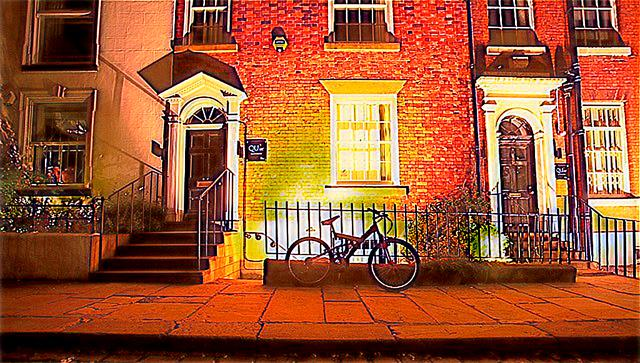

In [46]:
# # Load the image
# original = cv2.imread('/content/exdark_bright_mirnet/2015_00020.jpg')

# # Check the shape of the image
# height, width, channels = original.shape

# print("Height:", height)
# print("Width:", width)
# print("Channels:", channels)

# cv2_imshow(original)

In [ ]:
# Need to run the enhancement to 500 images for both mirnet and our pipleline, limit dark to 500 

In [47]:
# Running the data we prepared to finetune Faster RCNN from Dectron 2 (object detection library) from Facebook

In [48]:
# Install detectron

In [61]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities.
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

# Properly install detectron2. (Please do not install twice in both ways)
# !python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 25.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pyyaml: filename=PyYAML-5.1-cp310-cp310-linux_x86_64.whl size=44090 sha256=10c91b0d8a4de5858f0305b1d966343b7f5d2f5913f8b9a2b0cff02fc7f96935
  Stored in directory: /root/.cache/pip/wheels/70/83/31/975b737609aba39a4099d471d5684141c1fdc3404f97e7f68a
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 6.0
    Uninstalling PyYAML-6.0:
      Successfully uninstalled PyYAML-6.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
flax 0.6.9 requires PyYAML>=5.4.1, but you have pyyaml 5.1 which is incompatible.
dask 2022.12.1 requires pyyaml>=5.3.1, but you have pyyaml 5.1 which is incompatibl

In [62]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2022 NVIDIA Corporation
Built on Wed_Sep_21_10:33:58_PDT_2022
Cuda compilation tools, release 11.8, V11.8.89
Build cuda_11.8.r11.8/compiler.31833905_0
torch:  2.0 ; cuda:  cu118
detectron2: 0.6


In [63]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

In [64]:
import os
import random
import shutil

# Set the path to the directory containing the images and annotations
data_dir = '/content/exdark'

# Create two new directories for train and test data
train_dir = os.path.join(data_dir, 'train')
test_dir = os.path.join(data_dir, 'test')
os.makedirs(train_dir, exist_ok=True)
os.makedirs(test_dir, exist_ok=True)

# Get a list of all image files
img_files = [f for f in os.listdir(data_dir) if not f.endswith('.txt') and os.path.isfile(os.path.join(data_dir, f))]

# Shuffle the list of image files
random.shuffle(img_files)

print(len(img_files))

7363


In [65]:
# Split the data into training and testing sets
split_idx = int(0.8 * len(img_files))
train_files = img_files[:split_idx]
test_files = img_files[split_idx:]


# Copy the training files and corresponding annotation files to the train directory
for img_file in train_files:
    img_path = os.path.join(data_dir, img_file)
    img_name, img_ext = os.path.splitext(img_file)
    txt_files = [f for f in os.listdir(data_dir) if f.startswith(img_name) and f.endswith('.txt')]
    if len(txt_files) > 0:
        txt_file = txt_files[0]
        txt_path = os.path.join(data_dir, txt_file)
        shutil.copy(img_path, train_dir)
        shutil.copy(txt_path, train_dir)
    else:
      print("error" +img_file)

# Copy the testing files and corresponding annotation files to the test directory
for img_file in test_files:
    img_path = os.path.join(data_dir, img_file)
    img_name, img_ext = os.path.splitext(img_file)
    txt_files = [f for f in os.listdir(data_dir) if f.startswith(img_name) and f.endswith('.txt')]
    if len(txt_files) > 0:
        txt_file = txt_files[0]
        txt_path = os.path.join(data_dir, txt_file)
        shutil.copy(img_path, test_dir)
        shutil.copy(txt_path, test_dir)
    else:
      print("error" +img_file)

In [66]:
import glob
import os
from detectron2.data import DatasetCatalog, MetadataCatalog
from detectron2.structures import BoxMode

In [67]:
# Reference: https://github.com/Yashsshah909/Object-detection-of-low-light-images-using-the-Exclusively-Dark-ExDark-dataset./blob/main/Fast_RCNN_and_Faster_RCNN.ipynb

classes_num = ['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11']
classes_char = ['bicycle', 'boat', 'bottle', 'bus', 'car', 'cat', 'chair', 'cup', 'dog', 'motorbike', 'people', 'table']

def convert_data_to_dict(img_dir):
    # Get all annotation files in the specified directory
    annotation_files = glob.glob(img_dir +"/*.txt")
    result = []
    # Loop over each file
    for idx, file_path in enumerate(annotation_files):
        with open(file_path, "r") as f_o:
            lines = f_o.readlines()

            # Remove the first line if it matches the specified string
            if '% bbGt version=3\n' in lines:
                lines.remove('% bbGt version=3\n')
        
            data = {}
            # list to store the bounding boxes for this image
            bboxes = []
       
            for line in lines:
             
                j = line.split(' ')

                # dictionary to store the bounding box information
                box = {}

                # check if there are at least 4 elements in the split line
                if j != None and len(j) >= 4:

                    # Store the bounding box coordinates as a list
                    box['bbox'] = [int(j[1]), int(j[2]), int(j[3]), int(j[4])]

                    # Specify that the bounding box coordinates are in (x, y, w, h) format
                    box['bbox_mode'] = BoxMode.XYWH_ABS

                    # map the class name to its corresponding integer ID and store it in the dictionary
                    box['category_id'] = int(classes_num[classes_char.index(j[0].lower())])
                    bboxes.append(box)

            # Get the image file path by replacing the file extension of the annotation file
            p = file_path.split('.')[0] + '.' + file_path.split('.')[1]
            
            if os.path.exists(p):
                img = cv2.imread(p)

                # Store the list of bounding boxes 
                data['annotations'] = bboxes

                # Store the index of the image as its ID
                data['image_id'] = idx

                data['file_name'] = p

                if img is not None:
                    data['width'] = img.shape[1]
                    data['height'] = img.shape[0]

        # Check if the dictionary contains all required keys
        if len(data) == 5:
            # Append the dictionary to results
            result.append(data)
    # Return the list of dictionaries 
    return result

In [76]:
# # # Unregister the dataset from the DatasetCatalog
# DatasetCatalog.remove("boardetect_train")
# DatasetCatalog.remove("boardetect_test")

# # Unregister the metadata for the dataset from the MetadataCatalog
# MetadataCatalog.remove("boardetect_train")
# MetadataCatalog.remove("boardetect_test")

In [68]:
# list_classes = list(reverse_class_dict.keys())

# Regsiter all datasets

for d in ["train", "test"]:
  DatasetCatalog.register("boardetect_" + d, lambda d=d: convert_data_to_dict("exdark/" + d))
  MetadataCatalog.get("boardetect_" + d).set(thing_classes=classes_char)
  board_metadata = MetadataCatalog.get("boardetect_train")

for d in ["Ambient", "Object", "Single", "Strong", "Twilight", "Weak", "Window", "train"]:
  DatasetCatalog.register("boardetect_split_" + d, lambda d=d: convert_data_to_dict("exdark_split_light/" + d))
  MetadataCatalog.get("boardetect_split_" + d).set(thing_classes=classes_char)
  board_metadata = MetadataCatalog.get("boardetect_split_Ambient")

for d in ["train", "test"]:
  DatasetCatalog.register("boardetect_bright_" + d, lambda d=d: convert_data_to_dict("exdark_bright/" + d))
  MetadataCatalog.get("boardetect_bright_" + d).set(thing_classes=classes_char)
  board_metadata = MetadataCatalog.get("boardetect_bright_train")

for d in ["train", "test"]:
  DatasetCatalog.register("boardetect_bright_mirnet_" + d, lambda d=d: convert_data_to_dict("exdark_bright_mirnet/" + d))
  MetadataCatalog.get("boardetect_bright_mirnet_" + d).set(thing_classes=classes_char)
  board_metadata = MetadataCatalog.get("boardetect_bright_mirnet_train")

for d in ["train", "test"]:
  DatasetCatalog.register("boardetect_dark_" + d, lambda d=d: convert_data_to_dict("exdark_dark/" + d))
  MetadataCatalog.get("boardetect_dark_" + d).set(thing_classes=classes_char)
  board_metadata = MetadataCatalog.get("boardetect_dark_train")

for d in ["train", "test"]:
  DatasetCatalog.register("boardetect_base_" + d, lambda d=d: convert_data_to_dict("base/" + d))
  MetadataCatalog.get("boardetect_base_" + d).set(thing_classes=classes_char)
  board_metadata = MetadataCatalog.get("boardetect_base_train")



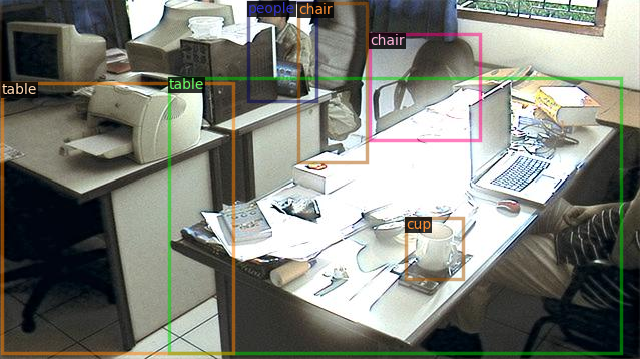

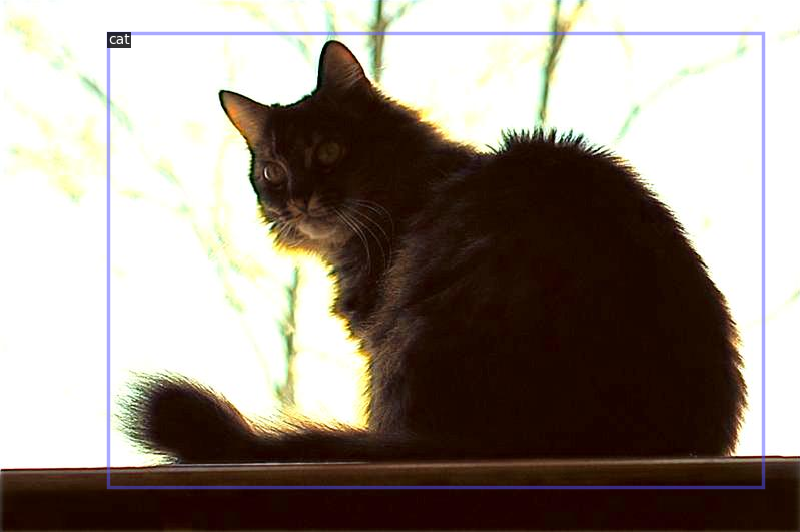

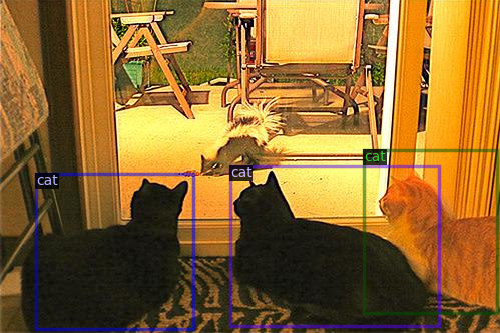

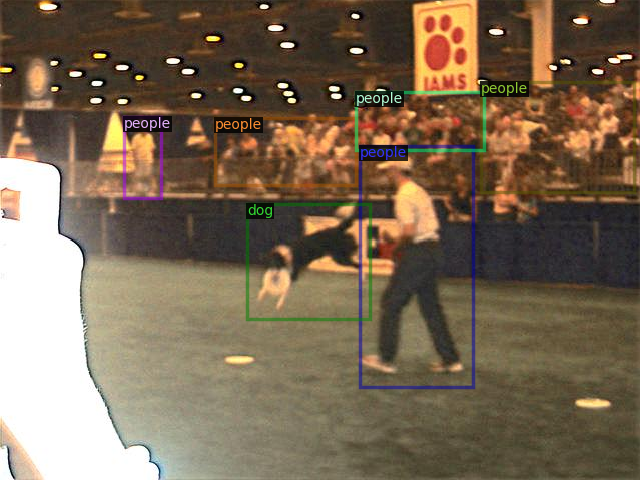

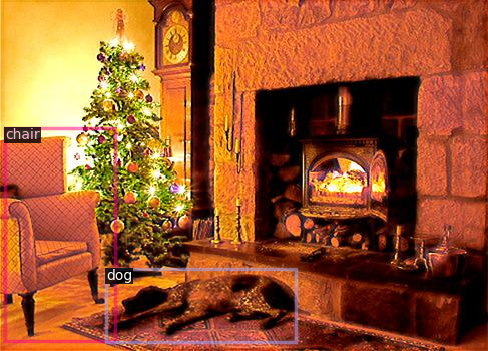

In [69]:
# Vis
board_metadata = MetadataCatalog.get("boardetect_bright_mirnet_train")
dataset_dictionary = convert_data_to_dict("exdark_bright_mirnet/train")
for d in random.sample(dataset_dictionary, 5):
  img = cv2.imread(d["file_name"])
  visualizer = Visualizer(img[:, :, ::-1], metadata=board_metadata)
  vis = visualizer.draw_dataset_dict(d)
  cv2_imshow(vis.get_image()[:, :, ::-1])

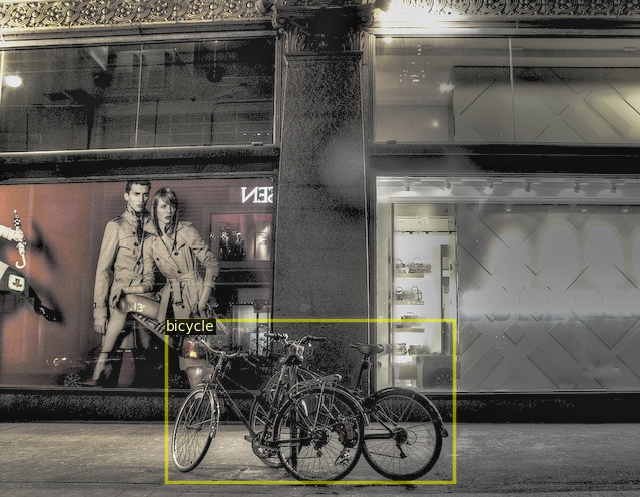

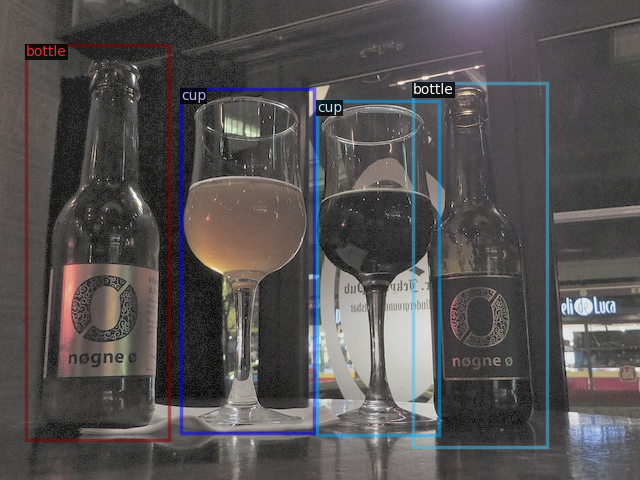

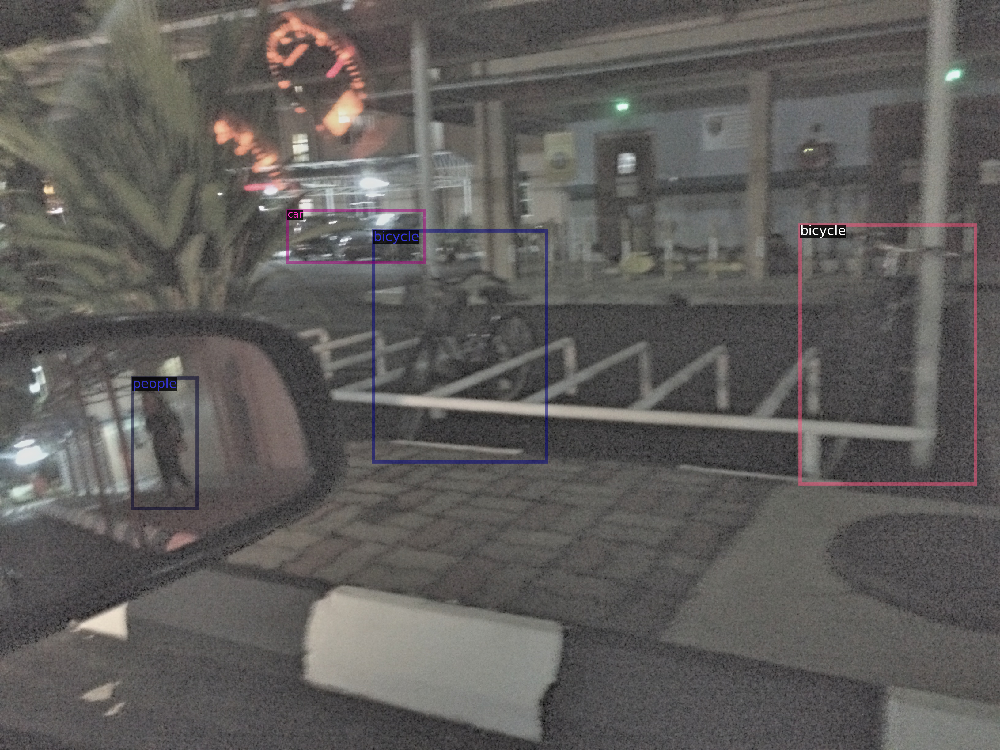

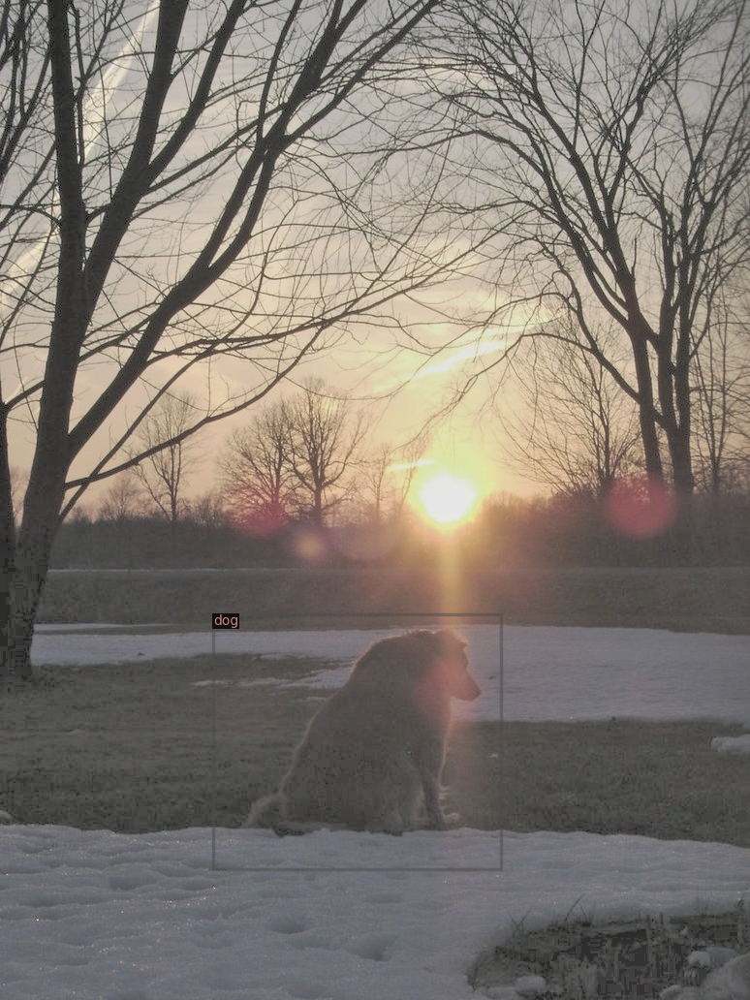

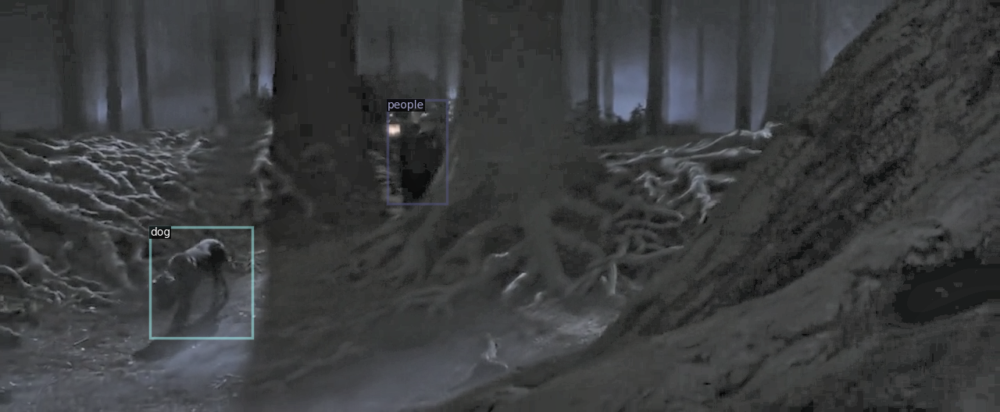

In [70]:
board_metadata = MetadataCatalog.get("boardetect_bright_train")
dataset_dictionary = convert_data_to_dict("exdark_bright/train")
for d in random.sample(dataset_dictionary, 5):
  img = cv2.imread(d["file_name"])
  visualizer = Visualizer(img[:, :, ::-1], metadata=board_metadata)
  vis = visualizer.draw_dataset_dict(d)
  cv2_imshow(vis.get_image()[:, :, ::-1])

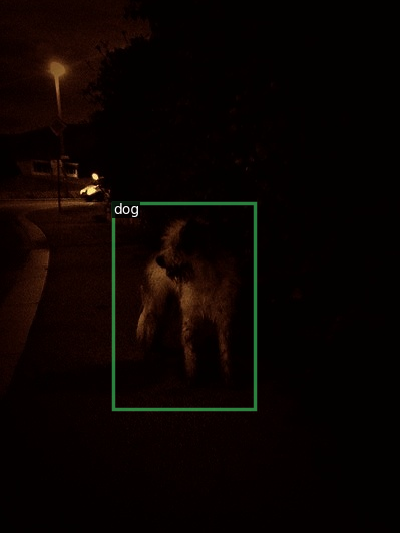

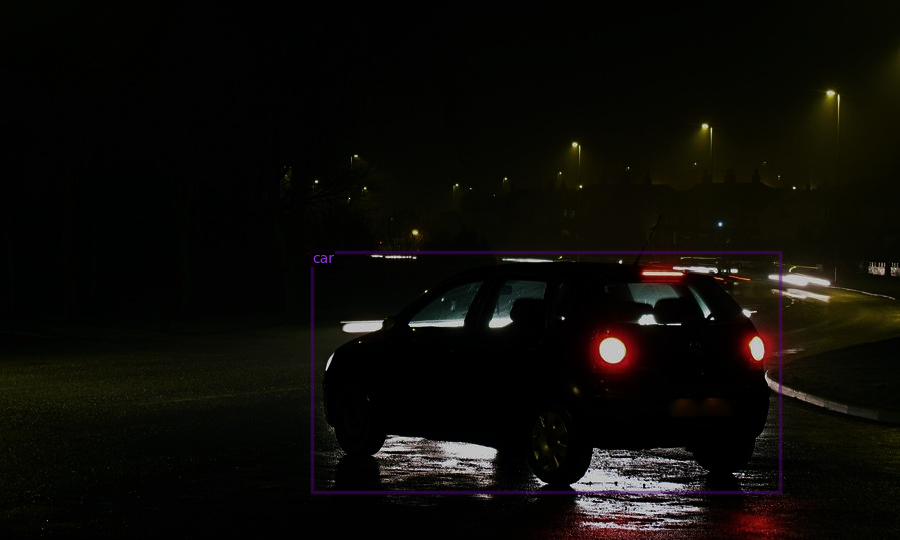

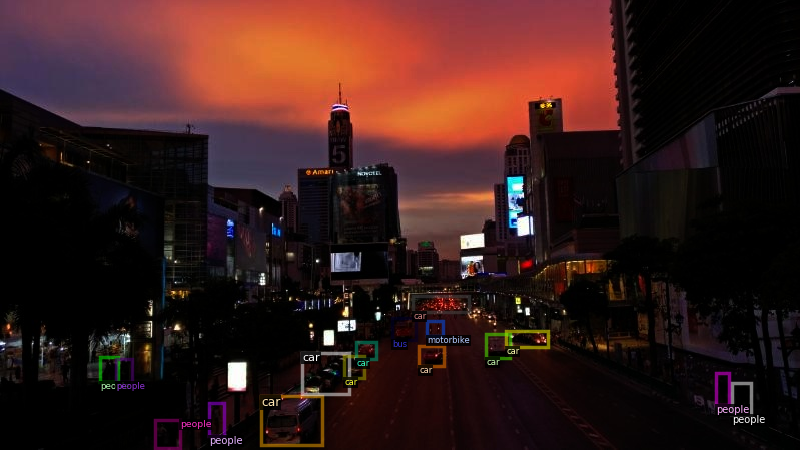

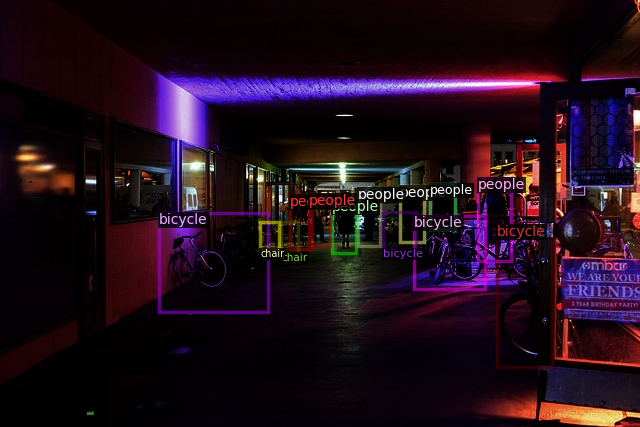

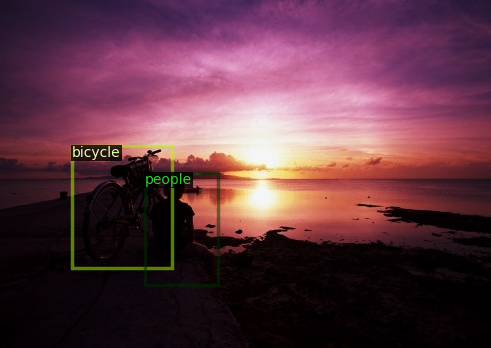

In [71]:
board_metadata = MetadataCatalog.get("boardetect_dark_train")
dataset_dictionary = convert_data_to_dict("exdark_dark/train")
for d in random.sample(dataset_dictionary, 5):
  img = cv2.imread(d["file_name"])
  visualizer = Visualizer(img[:, :, ::-1], metadata=board_metadata)
  vis = visualizer.draw_dataset_dict(d)
  cv2_imshow(vis.get_image()[:, :, ::-1])

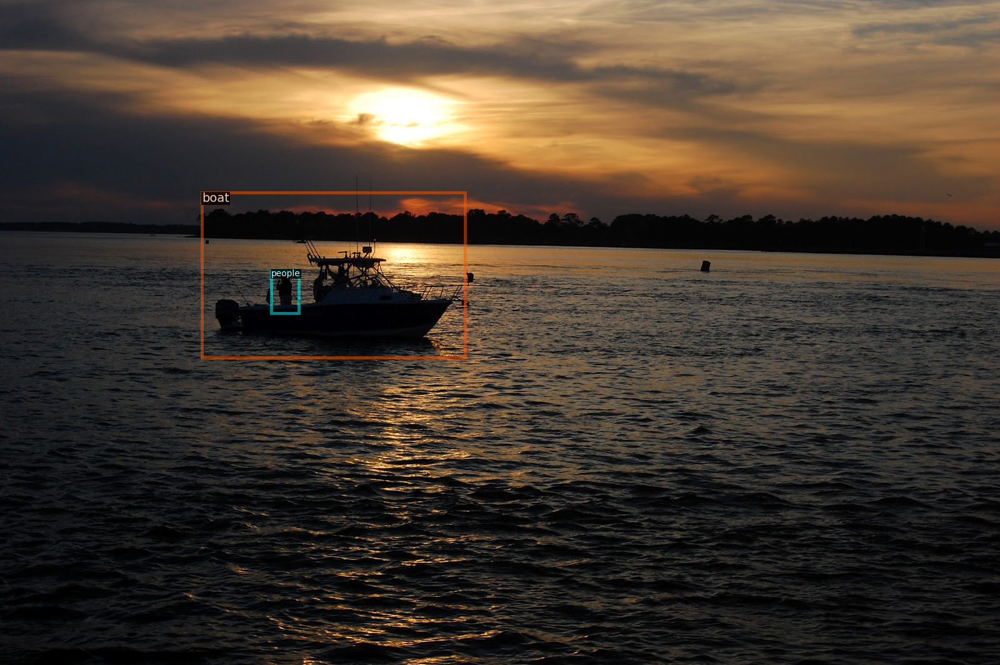

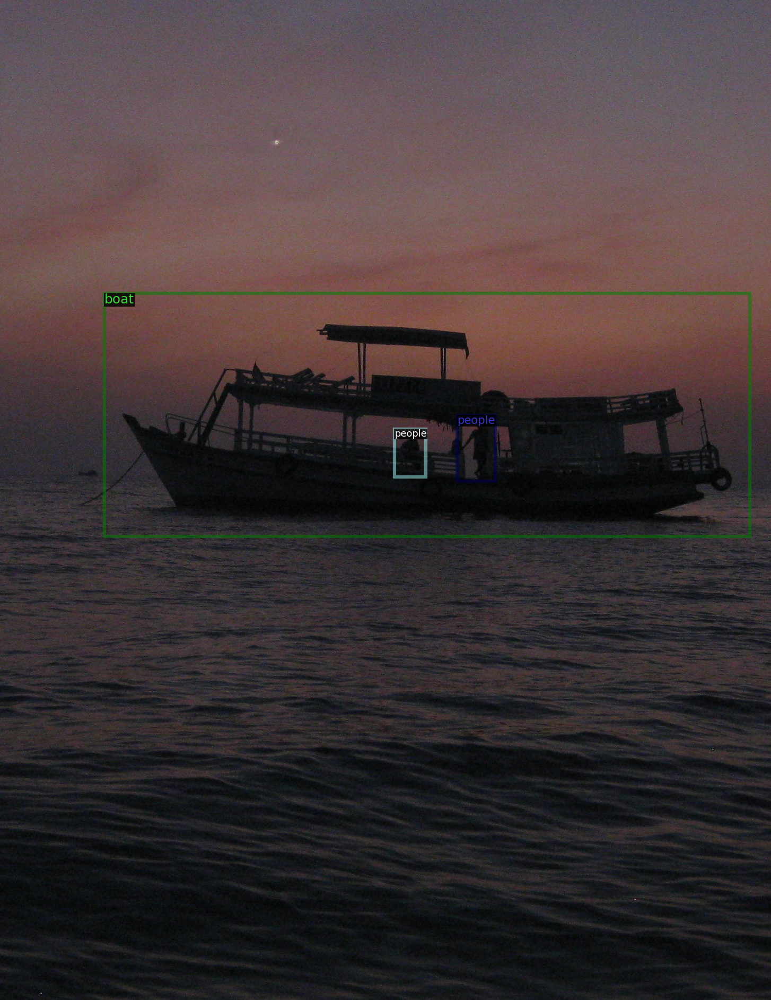

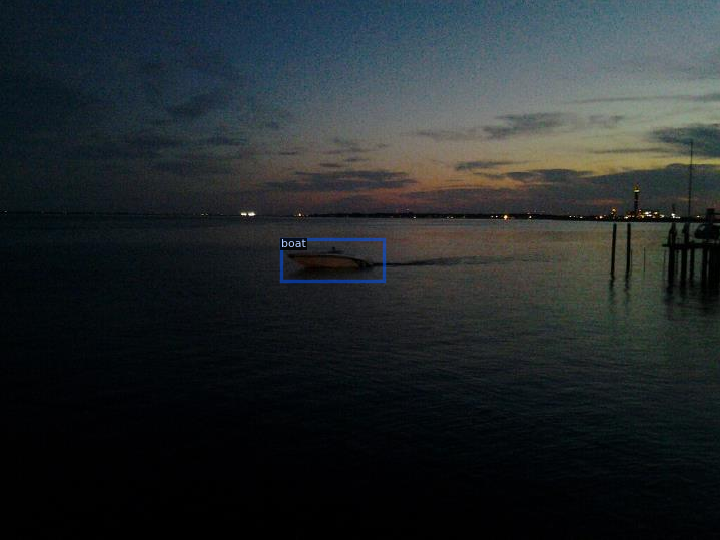

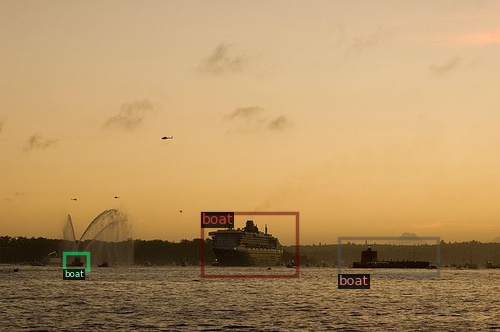

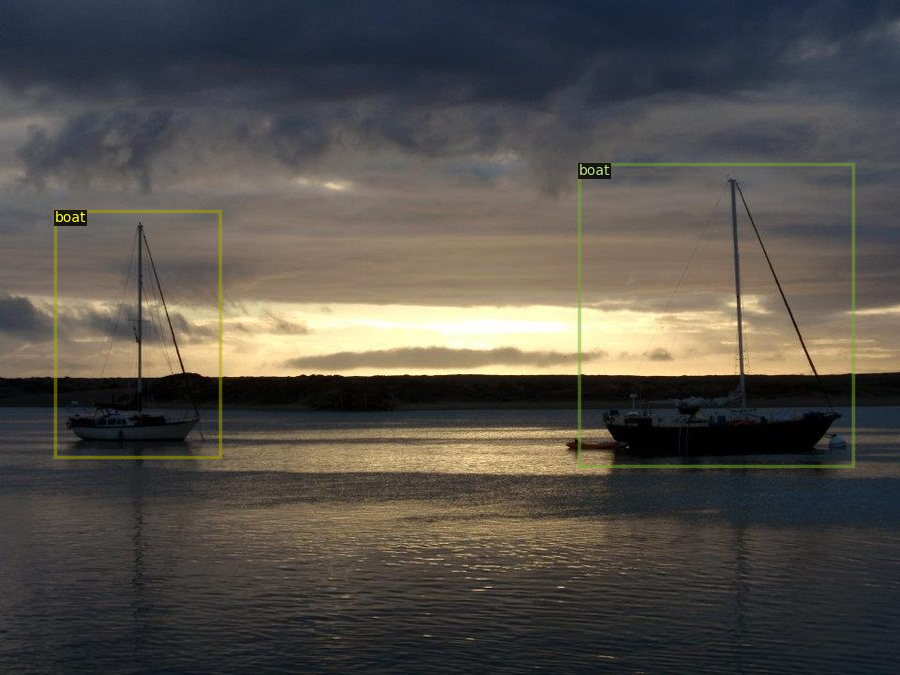

In [72]:
board_metadata = MetadataCatalog.get("boardetect_split_Twilight")
dataset_dictionary = convert_data_to_dict("exdark_split_light/Twilight")
for d in random.sample(dataset_dictionary, 5):
  img = cv2.imread(d["file_name"])
  visualizer = Visualizer(img[:, :, ::-1], metadata=board_metadata)
  vis = visualizer.draw_dataset_dict(d)
  cv2_imshow(vis.get_image()[:, :, ::-1])

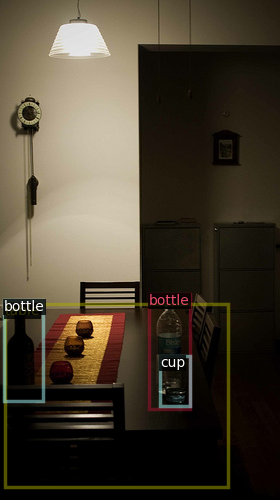

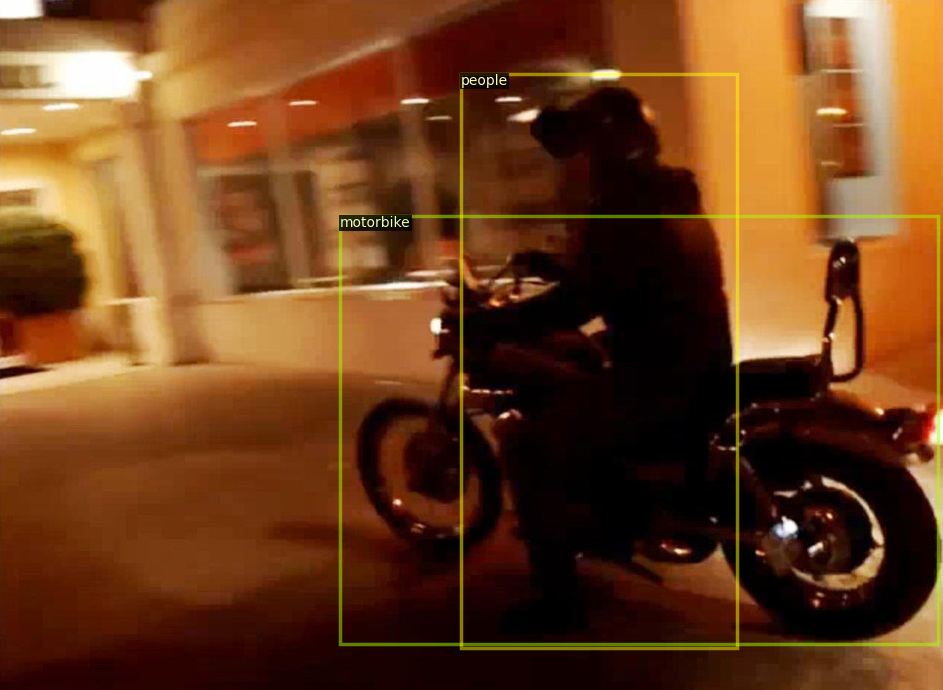

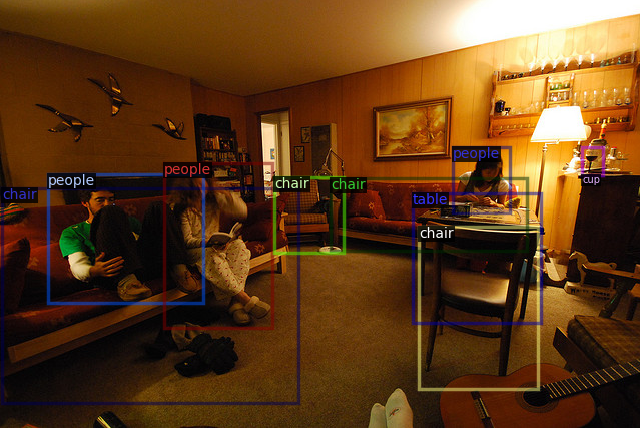

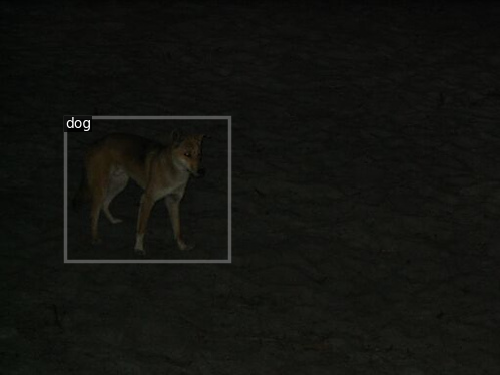

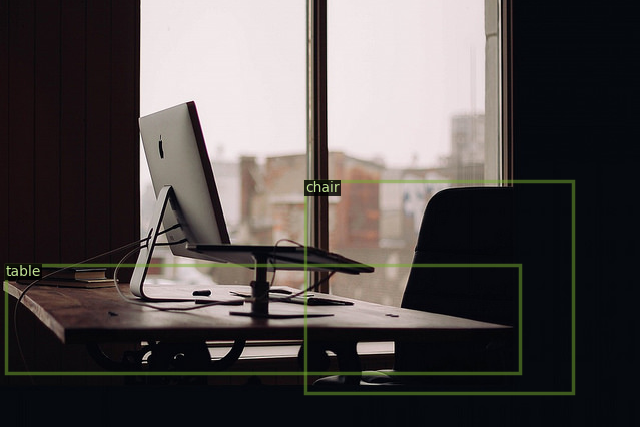

In [73]:
board_metadata = MetadataCatalog.get("boardetect_train")
dataset_dictionary = convert_data_to_dict("exdark/train")
for d in random.sample(dataset_dictionary, 5):
  img = cv2.imread(d["file_name"])
  visualizer = Visualizer(img[:, :, ::-1], metadata=board_metadata)
  vis = visualizer.draw_dataset_dict(d)
  cv2_imshow(vis.get_image()[:, :, ::-1])

In [74]:
#  From https://github.com/facebookresearch/detectron2/blob/main/tools/plain_train_net.py

import logging
import os
from collections import OrderedDict
import torch
from torch.nn.parallel import DistributedDataParallel

from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator
from detectron2.data import DatasetMapper, MetadataCatalog, build_detection_train_loader
import detectron2.data.transforms as T
from detectron2.data import DatasetMapper
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import os

import detectron2.utils.comm as comm
from detectron2.checkpoint import DetectionCheckpointer, PeriodicCheckpointer
from detectron2.config import get_cfg
from detectron2.data import (
    MetadataCatalog,
    build_detection_test_loader,
    build_detection_train_loader,
)
from detectron2.engine import default_argument_parser, default_setup, default_writers, launch
from detectron2.evaluation import (
    CityscapesInstanceEvaluator,
    CityscapesSemSegEvaluator,
    COCOEvaluator,
    COCOPanopticEvaluator,
    DatasetEvaluators,
    LVISEvaluator,
    PascalVOCDetectionEvaluator,
    SemSegEvaluator,
    inference_on_dataset,
    print_csv_format,
)
from detectron2.modeling import build_model
from detectron2.solver import build_lr_scheduler, build_optimizer
from detectron2.utils.events import EventStorage

logger = logging.getLogger("detectron2")


def get_evaluator(cfg, dataset_name, output_folder=None):
    """
    Create evaluator(s) for a given dataset.
    This uses the special metadata "evaluator_type" associated with each builtin dataset.
    For your own dataset, you can simply create an evaluator manually in your
    script and do not have to worry about the hacky if-else logic here.
    """
    if output_folder is None:
        os.makedirs("eval_res", exist_ok=True)
        output_folder = "eval_res"
    return COCOEvaluator(dataset_name, cfg, False, output_folder)


def do_test(cfg, model):
    results = OrderedDict()
    for dataset_name in cfg.DATASETS.TEST:
        data_loader = build_detection_test_loader(cfg, dataset_name)
        if not os.path.exists("eval_res"):
          os.makedirs("eval_res", exist_ok=True)
        output_folder = "eval_res"
        evaluator = COCOEvaluator(dataset_name, cfg, False, output_folder)
        results_i = inference_on_dataset(model, data_loader, evaluator)
        results[dataset_name] = results_i
        if comm.is_main_process():
            logger.info("Evaluation results for {} in csv format:".format(dataset_name))
            print_csv_format(results_i)
    if len(results) == 1:
        results = list(results.values())[0]
    return results


def do_train(cfg, model, resume=False):
    model.train()
    optimizer = build_optimizer(cfg, model)
    scheduler = build_lr_scheduler(cfg, optimizer)

    checkpointer = DetectionCheckpointer(
        model, cfg.OUTPUT_DIR, optimizer=optimizer, scheduler=scheduler
    )
    start_iter = (
        checkpointer.resume_or_load(cfg.MODEL.WEIGHTS, resume=resume).get("iteration", -1) + 1
    )
    max_iter = cfg.SOLVER.MAX_ITER

    periodic_checkpointer = PeriodicCheckpointer(
        checkpointer, cfg.SOLVER.CHECKPOINT_PERIOD, max_iter=max_iter
    )

    writers = default_writers(cfg.OUTPUT_DIR, max_iter) if comm.is_main_process() else []

    # compared to "train_net.py", we do not support accurate timing and
    # precise BN here, because they are not trivial to implement in a small training loop
    data_loader = build_detection_train_loader(cfg)
    logger.info("Starting training from iteration {}".format(start_iter))
    with EventStorage(start_iter) as storage:
        for data, iteration in zip(data_loader, range(start_iter, max_iter)):
            storage.iter = iteration

            loss_dict = model(data)
            losses = sum(loss_dict.values())
            assert torch.isfinite(losses).all(), loss_dict

            loss_dict_reduced = {k: v.item() for k, v in comm.reduce_dict(loss_dict).items()}
            losses_reduced = sum(loss for loss in loss_dict_reduced.values())
            if comm.is_main_process():
                storage.put_scalars(total_loss=losses_reduced, **loss_dict_reduced)

            optimizer.zero_grad()
            losses.backward()
            optimizer.step()
            storage.put_scalar("lr", optimizer.param_groups[0]["lr"], smoothing_hint=False)
            scheduler.step()

            if (
                cfg.TEST.EVAL_PERIOD > 0
                and (iteration + 1) % cfg.TEST.EVAL_PERIOD == 0
                and iteration != max_iter - 1
            ):
                do_test(cfg, model)
                # Compared to "train_net.py", the test results are not dumped to EventStorage
                comm.synchronize()

            if iteration - start_iter > 5 and (
                (iteration + 1) % 20 == 0 or iteration == max_iter - 1
            ):
                for writer in writers:
                    writer.write()
            periodic_checkpointer.step(iteration)






cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))

cfg.DATASETS.TRAIN = ("boardetect_train",)
cfg.DATASETS.TEST = ("boardetect_test",)

cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")

cfg.DATALOADER.NUM_WORKERS = 4
cfg.SOLVER.IMS_PER_BATCH = 4

cfg.SOLVER.BASE_LR = 0.01  

cfg.SOLVER.MAX_ITER = 7500 # about 5 epochs
cfg.TEST.EVAL_PERIOD = 1500   

cfg.MODEL.ROI_HEADS.NUM_CLASSES = 12 
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 256  

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

###

model = build_model(cfg)
logger.info("Model:\n{}".format(model))

distributed = comm.get_world_size() > 1
if distributed:
    model = DistributedDataParallel(
        model, device_ids=[comm.get_local_rank()], broadcast_buffers=False
    )

do_train(cfg, model, resume=False)
do_test(cfg, model)


[05/01 07:44:57 detectron2]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res2): Sequ

model_final_280758.pkl: 167MB [00:00, 178MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[05/01 07:46:06 d2.data.build]: Removed 1 images with no usable annotations. 5888 images left.
[05/01 07:46:06 d2.data.build]: Distribution of instances among all 12 categories:
|  category  | #instances   |  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|:----------:|:-------------|
|  bicycle   | 917          |    boat    | 1052         |   bottle   | 1300         |
|    bus     | 574          |    car     | 2336         |    cat     | 748          |
|   chair    | 1867         |    cup     | 1369         |    dog     | 803          |
| motorbike  | 863          |   people   | 5910         |   table    | 1138         |
|            |              |            |              |            |              |
|   total    | 18877        |            |              |            |              |
[05/01 07:46:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in training: [ResizeShortestEdge(short_edge_length=(640, 6

/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[05/01 07:46:15 d2.utils.events]:  iter: 19  total_loss: 2.827  loss_cls: 2.329  loss_box_reg: 0.4933  loss_rpn_cls: 0.01331  loss_rpn_loc: 0.01554     lr: 0.00019981  max_mem: 4211M
[05/01 07:46:19 d2.utils.events]:  eta: 0:24:58  iter: 39  total_loss: 1.26  loss_cls: 0.6754  loss_box_reg: 0.5585  loss_rpn_cls: 0.01726  loss_rpn_loc: 0.01643     lr: 0.00039961  max_mem: 4211M
[05/01 07:46:23 d2.utils.events]:  eta: 0:23:50  iter: 59  total_loss: 1.132  loss_cls: 0.5609  loss_box_reg: 0.5276  loss_rpn_cls: 0.01546  loss_rpn_loc: 0.0161     lr: 0.00059941  max_mem: 4212M
[05/01 07:46:27 d2.utils.events]:  eta: 0:20:22  iter: 79  total_loss: 1.149  loss_cls: 0.5475  loss_box_reg: 0.5714  loss_rpn_cls: 0.01332  loss_rpn_loc: 0.01829     lr: 0.00079921  max_mem: 4212M
[05/01 07:46:30 d2.utils.events]:  eta: 0:23:12  iter: 99  total_loss: 1.083  loss_cls: 0.5098  loss_box_reg: 0.5578  loss_rpn_cls: 0.01129  loss_rpn_loc: 0.01303     lr: 0.00099901  max_mem: 4212M
[05/01 07:46:34 d2.utils.ev

KeyboardInterrupt: ignored

In [83]:
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator
from detectron2.data import DatasetMapper, MetadataCatalog, build_detection_train_loader
import detectron2.data.transforms as T
from detectron2.data import DatasetMapper
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import os

class MyTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):
    if output_folder is None:
        os.makedirs("eval_res", exist_ok=True)
        output_folder = "eval_res"
    return COCOEvaluator(dataset_name, cfg, False, output_folder)

  @classmethod
  def build_train_loader(cls, cfg):
    return build_detection_train_loader(cfg,
   mapper=DatasetMapper(cfg, is_train=True, augmentations=[
    T.ResizeShortestEdge(short_edge_length=(640, 672, 704, 736, 768, 800), max_size=1333, sample_style='choice'),
    T.RandomFlip(),
   ]))

  # classmethod
  # def build_lr_scheduler(cls, cfg, optimizer):
  #   """
  #   It now calls :func:`detectron2.solver.build_lr_scheduler`.
  #   Overwrite it if you'd like a different scheduler.
  #   """
  #   return build_lr_scheduler(cfg, optimizer)


cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))

cfg.DATASETS.TRAIN = ("boardetect_train",)
cfg.DATASETS.TEST = ("boardetect_test",)

cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")

cfg.DATALOADER.NUM_WORKERS = 4
cfg.SOLVER.IMS_PER_BATCH = 4

cfg.SOLVER.BASE_LR = 0.01  

cfg.SOLVER.MAX_ITER = 37500 # about 5 epochs
cfg.TEST.EVAL_PERIOD = 7500   

cfg.MODEL.ROI_HEADS.NUM_CLASSES = 12 
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 256  

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

trainer = MyTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[05/01 08:40:40 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[05/01 08:41:48 d2.engine.train_loop]: Starting training from iteration 0
[05/01 08:41:53 d2.utils.events]:  eta: 1:41:53  iter: 19  total_loss: 2.862  loss_cls: 2.356  loss_box_reg: 0.5039  loss_rpn_cls: 0.01421  loss_rpn_loc: 0.01694    time: 0.1721  last_time: 0.1432  data_time: 0.0655  last_data_time: 0.0040   lr: 0.00019981  max_mem: 7621M
[05/01 08:41:56 d2.utils.events]:  eta: 1:40:53  iter: 39  total_loss: 1.281  loss_cls: 0.6984  loss_box_reg: 0.5461  loss_rpn_cls: 0.01488  loss_rpn_loc: 0.01445    time: 0.1741  last_time: 0.1529  data_time: 0.0279  last_data_time: 0.0075   lr: 0.00039961  max_mem: 7712M
[05/01 08:41:59 d2.utils.events]:  eta: 1:37:27  iter: 59  total_loss: 1.142  loss_cls: 0.5726  loss_box_reg: 0.552  loss_rpn_cls: 0.01926  loss_rpn_loc: 0.0144    time: 0.1684  last_time: 0.1543  data_time: 0.0150  last_data_time: 0.0047   lr: 0.00059941  max_mem: 7712M
[05/01 08:42:03 d2.utils.events]:  eta: 1:37:24  iter: 79  total_loss: 1.135  loss_cls: 0.4948  loss_box_re

In [84]:
%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

[05/01 10:40:24 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


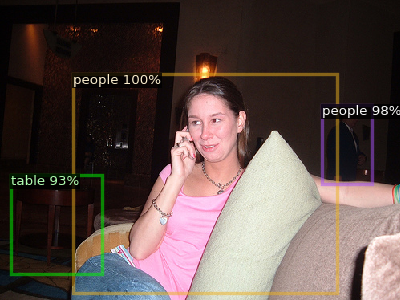

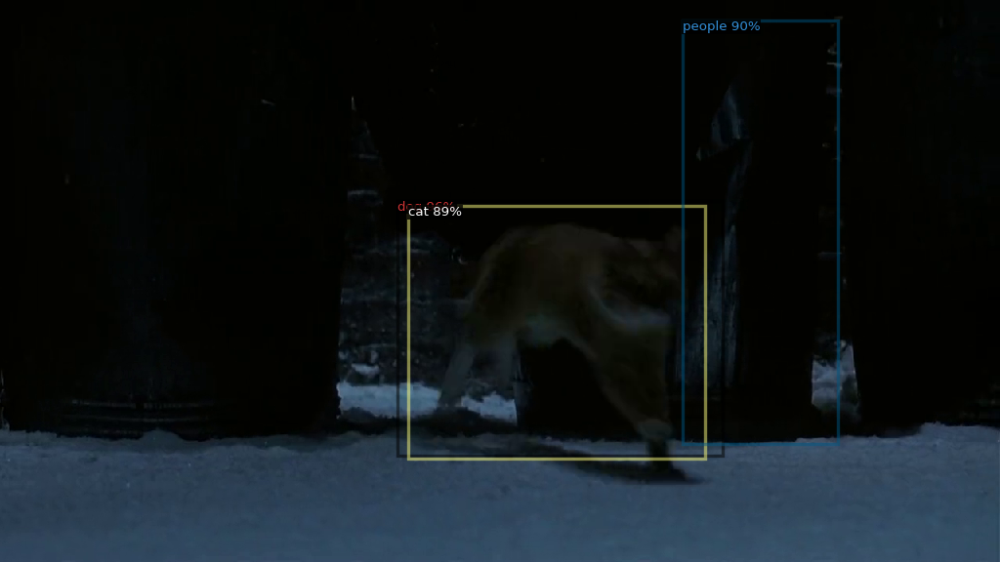

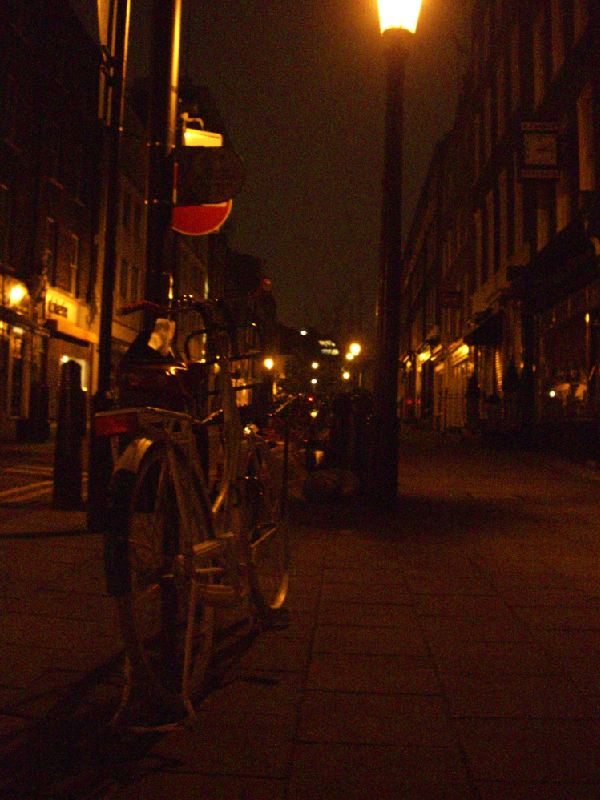

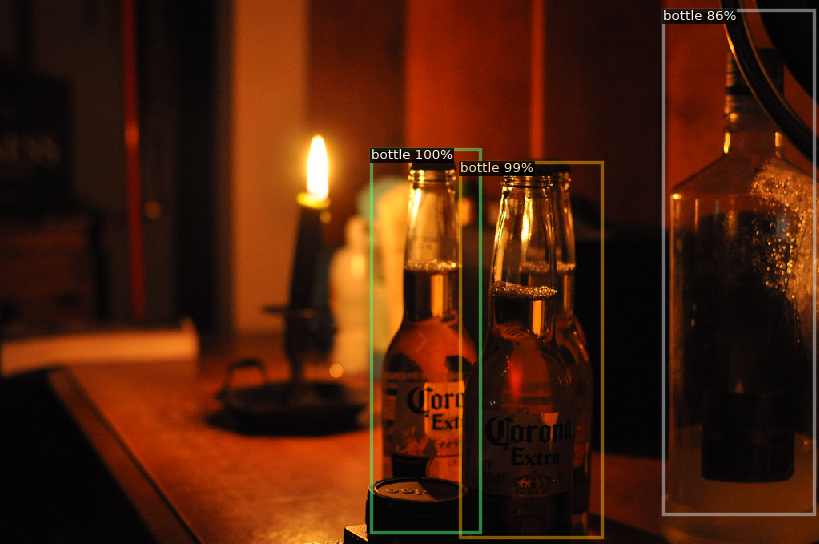

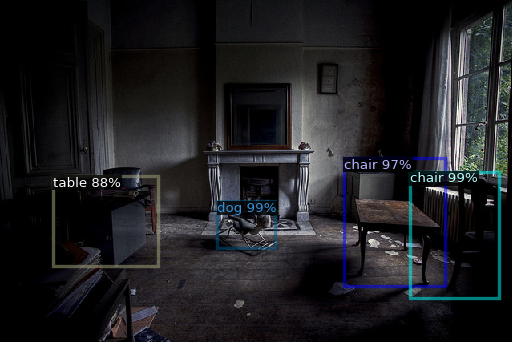

In [85]:
from detectron2.utils.visualizer import ColorMode

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")

cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7 

cfg.DATASETS.TEST = ("boardetect_test", )

predictor = DefaultPredictor(cfg)

dataset_dicts = convert_data_to_dict("exdark/test")

board_metadata = MetadataCatalog.get("boardetect_train")

for d in random.sample(dataset_dicts, 5): 

    im = cv2.imread(d["file_name"])
    outputs = predictor(im)

    v = Visualizer(im[:, :, ::-1],
                   metadata=board_metadata, 
                   scale=0.8,
                   instance_mode=ColorMode.IMAGE   # remove the colors of unsegmented pixels
    )

    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])

In [86]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

evaluator = COCOEvaluator("boardetect_test", cfg, False, output_dir="/output/")

val_loader = build_detection_test_loader(cfg, "boardetect_test")

inference_on_dataset(predictor.model, val_loader, evaluator)

[05/01 10:40:41 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
WARNING [05/01 10:40:41 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[05/01 10:40:57 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[05/01 10:40:57 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[05/01 10:40:57 d2.data.common]: Serializing 1473 elements to byte tensors and concatenating them all ...
[05/01 10:40:57 d2.data.common]: Serialized dataset takes 0.38 MiB
[05/01 10:40:57 d2.evaluation.evaluator]: Start inference on 1473 batches
[05/01 10:40:58 d2.evaluation.evaluator]: Inference done 11/1473. Dataloading: 0.0008 s/iter. Inference: 0.0267 s/iter. Eval: 0.0003 s/iter. Total: 0.0277 s/iter. ETA=0:00:4

OrderedDict([('bbox',
              {'AP': 36.25126967694642,
               'AP50': 61.724235767239,
               'AP75': 39.49695488019621,
               'APs': 21.57802186897038,
               'APm': 25.148422033945973,
               'APl': 42.15118439766374,
               'AP-bicycle': 48.012819173475,
               'AP-boat': 25.224347495417458,
               'AP-bottle': 30.129428904312572,
               'AP-bus': 57.445185142385,
               'AP-car': 44.42398712532526,
               'AP-cat': 29.424613501544588,
               'AP-chair': 26.458512261114674,
               'AP-cup': 41.225087267106304,
               'AP-dog': 38.26919689987485,
               'AP-motorbike': 35.349746497723174,
               'AP-people': 38.30742610732267,
               'AP-table': 20.74488574775553})])

In [ ]:
# Do training to test different lighting conditions

board_metadata = MetadataCatalog.get("boardetect_split_train")
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))

cfg.DATASETS.TRAIN = ("boardetect_split_train",)
cfg.DATASETS.TEST = ("boardetect_split_Ambient", "boardetect_split_Object", "boardetect_split_Single", "boardetect_split_Strong", "boardetect_split_Twilight", "boardetect_split_Weak", "boardetect_split_Window")

cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")

cfg.DATALOADER.NUM_WORKERS = 4
cfg.SOLVER.IMS_PER_BATCH = 4

cfg.SOLVER.BASE_LR = 0.01  

cfg.SOLVER.MAX_ITER = 17500 # about 5 epochs
cfg.TEST.EVAL_PERIOD = 3500   

cfg.MODEL.ROI_HEADS.NUM_CLASSES = 12 
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 256  

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

trainer = MyTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[05/01 10:41:50 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[05/01 10:42:01 d2.engine.train_loop]: Starting training from iteration 0
[05/01 10:42:05 d2.utils.events]:  eta: 0:46:46  iter: 19  total_loss: 2.841  loss_cls: 2.41  loss_box_reg: 0.5484  loss_rpn_cls: 0.0141  loss_rpn_loc: 0.01773    time: 0.1596  last_time: 0.1421  data_time: 0.0410  last_data_time: 0.0071   lr: 0.00019981  max_mem: 7715M
[05/01 10:42:08 d2.utils.events]:  eta: 0:46:12  iter: 39  total_loss: 1.224  loss_cls: 0.6536  loss_box_reg: 0.5233  loss_rpn_cls: 0.01293  loss_rpn_loc: 0.01496    time: 0.1580  last_time: 0.1523  data_time: 0.0091  last_data_time: 0.0150   lr: 0.00039961  max_mem: 7715M
[05/01 10:42:11 d2.utils.events]:  eta: 0:45:38  iter: 59  total_loss: 1.239  loss_cls: 0.598  loss_box_reg: 0.5306  loss_rpn_cls: 0.01564  loss_rpn_loc: 0.01601    time: 0.1587  last_time: 0.1668  data_time: 0.0140  last_data_time: 0.0114   lr: 0.00059941  max_mem: 7715M
[05/01 10:42:15 d2.utils.events]:  eta: 0:45:44  iter: 79  total_loss: 1.313  loss_cls: 0.624  loss_box_reg:

In [ ]:
%load_ext tensorboard
%tensorboard --logdir output

In [ ]:
# Do training to test base line images

board_metadata = MetadataCatalog.get("boardetect_base_train")
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))

cfg.DATASETS.TRAIN = ("boardetect_base_train",)
cfg.DATASETS.TEST = ("boardetect_base_test",)

cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")

cfg.DATALOADER.NUM_WORKERS = 4
cfg.SOLVER.IMS_PER_BATCH = 4

cfg.SOLVER.BASE_LR = 0.01  

cfg.SOLVER.MAX_ITER = 15000 
cfg.TEST.EVAL_PERIOD = 5000   

cfg.MODEL.ROI_HEADS.NUM_CLASSES = 12 
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 256  

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

trainer = MyTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

In [ ]:
%load_ext tensorboard
%tensorboard --logdir output

In [ ]:
# Do training to test dark images

board_metadata = MetadataCatalog.get("boardetect_dark_train")
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))

cfg.DATASETS.TRAIN = ("boardetect_dark_train",)
cfg.DATASETS.TEST = ("boardetect_dark_test",)

cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")

cfg.DATALOADER.NUM_WORKERS = 4
cfg.SOLVER.IMS_PER_BATCH = 4

cfg.SOLVER.BASE_LR = 0.01  

cfg.SOLVER.MAX_ITER = 15000 
cfg.TEST.EVAL_PERIOD = 5000   

cfg.MODEL.ROI_HEADS.NUM_CLASSES = 12 
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 256  

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

trainer = MyTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

In [ ]:
%load_ext tensorboard
%tensorboard --logdir output

In [ ]:
# Do training to test bright images

board_metadata = MetadataCatalog.get("boardetect_bright_train")
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))

cfg.DATASETS.TRAIN = ("boardetect_bright_train",)
cfg.DATASETS.TEST = ("boardetect_bright_test",)

cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")

cfg.DATALOADER.NUM_WORKERS = 4
cfg.SOLVER.IMS_PER_BATCH = 4

cfg.SOLVER.BASE_LR = 0.01  

cfg.SOLVER.MAX_ITER = 15000 
cfg.TEST.EVAL_PERIOD = 5000   

cfg.MODEL.ROI_HEADS.NUM_CLASSES = 12 
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 256  

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

trainer = MyTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

In [ ]:
%load_ext tensorboard
%tensorboard --logdir output

In [ ]:
# Do training to test bright mir images

board_metadata = MetadataCatalog.get("boardetect_bright_mirnet_train")
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))

cfg.DATASETS.TRAIN = ("boardetect_bright_mirnet_train",)
cfg.DATASETS.TEST = ("boardetect_bright_mirnet_test",)

cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")

cfg.DATALOADER.NUM_WORKERS = 4
cfg.SOLVER.IMS_PER_BATCH = 4

cfg.SOLVER.BASE_LR = 0.01  

cfg.SOLVER.MAX_ITER = 15000 
cfg.TEST.EVAL_PERIOD = 5000   

cfg.MODEL.ROI_HEADS.NUM_CLASSES = 12 
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 256  

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

trainer = MyTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

In [ ]:
%load_ext tensorboard
%tensorboard --logdir output

In [ ]:
# Retina net

In [ ]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/retinanet_R_50_FPN_3x.yaml"))

cfg.DATASETS.TRAIN = ("boardetect_train",)
cfg.DATASETS.TEST = ("boardetect_test",)

cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/retinanet_R_50_FPN_3x.yaml")

cfg.DATALOADER.NUM_WORKERS = 4
cfg.SOLVER.IMS_PER_BATCH = 4

cfg.SOLVER.BASE_LR = 0.01  

cfg.SOLVER.MAX_ITER = 37500 # about 5 epochs
cfg.TEST.EVAL_PERIOD = 7500   

cfg.MODEL.ROI_HEADS.NUM_CLASSES = 12 
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 256  

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

trainer = MyTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

In [ ]:
%load_ext tensorboard
%tensorboard --logdir output

In [ ]:
# Fast RCNN

In [ ]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/fast_rcnn_R_50_FPN_1x.yaml"))

cfg.DATASETS.TRAIN = ("boardetect_train",)
cfg.DATASETS.TEST = ("boardetect_test",)

cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/fast_rcnn_R_50_FPN_1x.yaml")

cfg.DATALOADER.NUM_WORKERS = 4
cfg.SOLVER.IMS_PER_BATCH = 4

cfg.SOLVER.BASE_LR = 0.01  

cfg.SOLVER.MAX_ITER = 37500 # about 5 epochs
cfg.TEST.EVAL_PERIOD = 7500   

cfg.MODEL.ROI_HEADS.NUM_CLASSES = 12 
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 256  

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

trainer = MyTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

In [ ]:
%load_ext tensorboard
%tensorboard --logdir output